
[comment]: # (Arquivos de imagens embutidos no jupyter notebook por meio de URL em base 64)

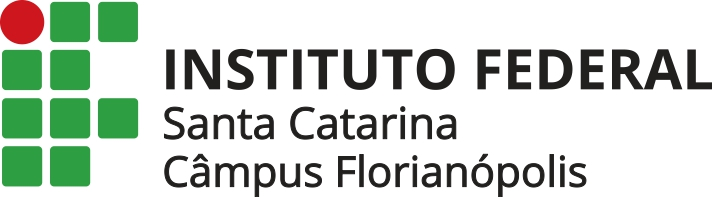 
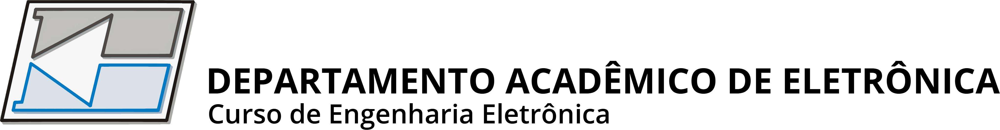

## Unidade Curricular: DSP2 <br> Professor: Fernando Santana Pacheco <br> Aluno: Gustavo Vianna França

# Projeto e implementação de filtros digitais<a id='relatorio'></a>

Toma-se conhecimento da existência de uma gravação de áudio que está mascarada por um sinal espúrio de alguma frequência. Assim, essa gravação deve ser filtrada para obter o sinal de interesse. Por meio de filtros digitais dos tipos _FIR_, _IIR_ e _notch_, ela tem o ruído atenuado ou eliminado.

Além do projeto e aplicação dos filtros no computador, também é feita a implementação em _hardware_, na qual provém limitações que determinam importantes parâmetros na realização dos filtros. Antes do ínicio do projeto, as bibliotecas e funções necessárias para a sua execução são importadas a seguir:

Bibliotecas necessárias:
- [IPython (Jupyter Notebook)](https://jupyter.org/)
- [numpy](https://numpy.org/)
- [scipy](https://www.scipy.org/)
- [matplotlib](https://matplotlib.org/)

In [1]:
# Inicialização de bibliotecas e funções.
from IPython.display import (Image, Audio, display, clear_output) # Widget com os botões de play, volume e download.
import numpy as np
from numpy import loadtxt # Necessário para carregar coeficientes externos do filtro FIR.
import scipy as scp
from scipy.io import wavfile
from scipy import signal
import matplotlib.pyplot as plt # Para desenho.
import math
import cmath

%matplotlib inline
plt.rcParams.update({'figure.figsize':[13.24,9],
                     'font.size': 22, 
                     'xaxis.labellocation': 'right',
                     'yaxis.labellocation': 'top'});

zeros = lambda w : [(2*math.cos(w)+cmath.sqrt(4*(math.cos(w))**2-4))/2,
                    (2*math.cos(w)-cmath.sqrt(4*(math.cos(w))**2-4))/2];
poles = lambda a, p, w : [(2*(p+a)*math.cos(w)+cmath.sqrt(4*((p+a)**2)*(math.cos(w))**2-4*(1+a)*(p**2+a)))/(2*(1+a)),
                          (2*(p+a)*math.cos(w)-cmath.sqrt(4*((p+a)**2)*(math.cos(w))**2-4*(1+a)*(p**2+a)))/(2*(1+a))];
gain = lambda a : (1-a);

def increase_range_steps(original_range, lower_bound, higher_bound, step_num):
    if type(lower_bound) is not int or lower_bound < 0:
        raise TypeError('The lower_bound argument must be a positive integer!');
    elif type(higher_bound) is not int or higher_bound < 0:
        raise TypeError('The higher_bound argument must be a positive integer!');
    elif type(step_num) is not int or step_num < 0:
        raise TypeError('The step_num argument must be a positive integer!');
    elif lower_bound > higher_bound:
        raise ValueError('The lower_bound argument must smaller than the higher_bound argument!');
    elif len(original_range)-1 < lower_bound:
        raise ValueError('The lower_bound argument must be in the range of original_range!');
    elif len(original_range)-1 < higher_bound:
        raise ValueError('The higher_bound argument must be in the range of original_range!');

    index_l = int(np.argwhere(original_range<lower_bound)[-1]);
    index_h = int(np.argwhere(original_range>higher_bound)[0]);
    new_range = np.linspace(original_range[index_l], original_range[index_h], int((step_num)+(index_h-index_l)));
    modified_range = np.append(original_range[:index_l], new_range);
    modified_range = np.append(modified_range, original_range[index_h:]);
    return modified_range;

# Sumário<a id='sumario'></a>

- [Projeto e implementação de filtros digitais](#relatorio)
- [Sumário](#sumario)
- 1 [Identificação do sinal espúrio no áudio](#desenvolvimento:1)
- 2 [Requisitos de projeto](#desenvolvimento:2)
- 3 [Projeto de um filtro _FIR_](#desenvolvimento:3)
    - 3.1 [Gráfico da magnitude da resposta em frequência do filtro _FIR_](#desenvolvimento:3-1)
    - 3.2 [Sinal filtrado por filtro _FIR_](#desenvolvimento:3-2)
- 4 [Implementação do filtro _FIR_ em _hardware_](#desenvolvimento:4)
    - 4.1 [Filtro _FIR_ em ponto flutuante](#desenvolvimento:4-1)
    - 4.2 [Comparação entre o Filtro _FIR_ simulado e implementado em _hardware_](#desenvolvimento:4-2)
    - 4.3 [Filtro _FIR_ em ponto fixo](#desenvolvimento:4-3)
    - 4.4 [Comparação entre o Filtro _FIR_ em ponto flutuante e em ponto fixo](#desenvolvimento:4-4)
- 5 [Projeto de um filtro _IIR_](#desenvolvimento:5)
    - 5.1 [Gráfico da magnitude da resposta em frequência do filtro _IIR_](#desenvolvimento:5-1)
    - 5.2 [Sinal filtrado por filtro _IIR_](#desenvolvimento:5-2)
- 6 [Implementação do filtro _IIR_ em _hardware_](#desenvolvimento:6)
- 7 [Projeto de um filtro _notch_](#desenvolvimento:7)
    - 7.1 [Gráfico da magnitude da resposta em frequência do filtro _notch_](#desenvolvimento:7-1)
    - 7.2 [Sinal filtrado por filtro _notch_](#desenvolvimento:7-2)
- 8 [Implementação do filtro _notch_ em _hardware_](#desenvolvimento:8)
- 9 [Comparação entre filtros](#desenvolvimento:9)
- [Referências](#referencias)

# 1 Identificação do sinal espúrio no áudio<a id='desenvolvimento:1'></a>

Inicialmente, o arquivo `'audio-teste-ruido-gustavo.wav'` é observado no programa [OcenAudio](https://www.ocenaudio.com/). Nas [Figura 1](#fig:1) e [Figura 2](#fig:2) é identificado um tom reincidente sobre a voz no áudio, e na [Figura 3](#fig:3), a sua frequência é encontrada próxima a 995 Hz.

<a id='fig:1'></a>

<figcaption>
    <center>
        <b>Figura 1</b> - Espectro do áudio ruidoso no OcenAudio.
    </center>
</figcaption>

[comment]: # (Arquivos de imagens embutidos no jupyter notebook por meio de URL em base 64)

<center>
    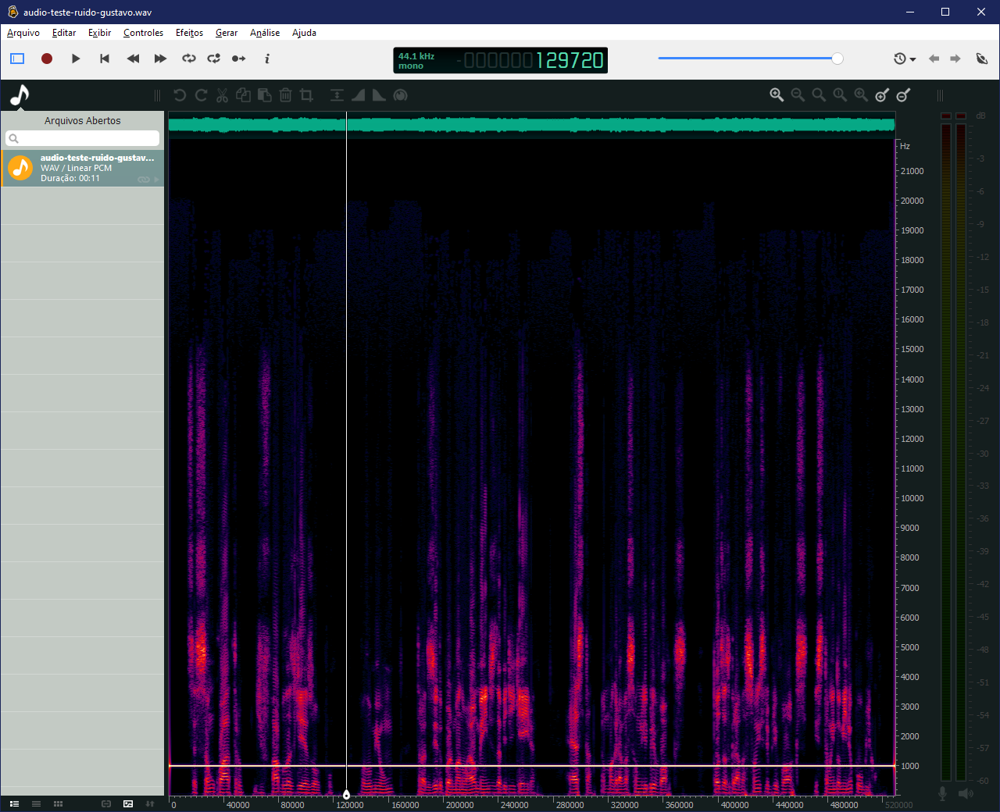
</center>

<figcaption>
    <center>
        <b>Fonte:</b> o autor.
    </center>
</figcaption>

<a id='fig:2'></a>

<figcaption>
    <center>
        <b>Figura 2</b> - Análise <i>FFT</i> do áudio ruidoso no OcenAudio.
    </center>
</figcaption>

[comment]: # (Arquivos de imagens embutidos no jupyter notebook por meio de URL em base 64)

<center>
    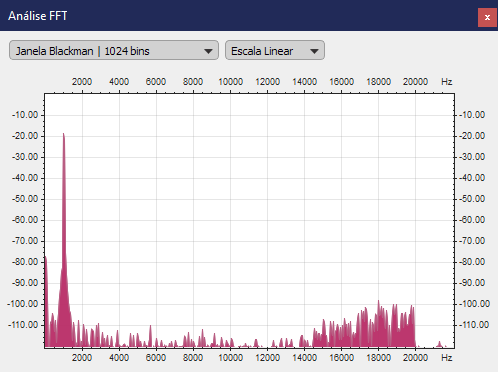
</center>

<figcaption>
    <center>
        <b>Fonte:</b> o autor.
    </center>
</figcaption>

<a id='fig:3'></a>

<figcaption>
    <center>
        <b>Figura 3</b> - Frequência do áudio ruidoso no OcenAudio.
    </center>
</figcaption>

[comment]: # (Arquivos de imagens embutidos no jupyter notebook por meio de URL em base 64)

<center>
    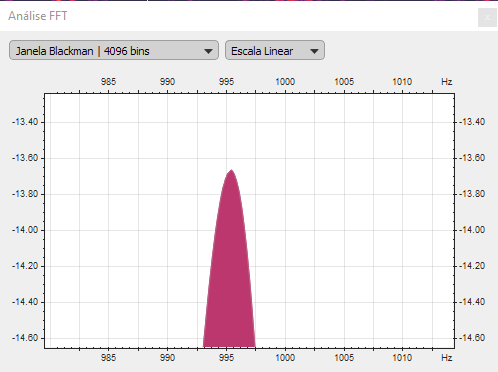
</center>

<figcaption>
    <center>
        <b>Fonte:</b> o autor.
    </center>
</figcaption>

# 2 Requisitos de projeto<a id='desenvolvimento:2'></a>

Para o projeto do filtro, é ideal que ele tivesse os seguintes requisitos:

1. Frequências de corte inferior e superior próximas a frequência do sinal espúrio de 995 Hz.
2. Atenuação de pelo menos 70 dB na banda de rejeição para aproximar a magnitude das frequências vizinhas.
3. Frequência de amostragem de 48 kHz para a implementação na placa de desenvolvimento STM32F4 Discovery.
4. Ordem do filtro _FIR_ deve ser menor que 600 para sua implementação em _hardware_.
5. Filtros _IIR_ e _notch_ devem ter ordem menor ou igual a 10 para suas implementações em _hardware_.

Desse modo, é dada sequência ao projeto para cada filtro. 

# 3 Projeto de um filtro _FIR_<a id='desenvolvimento:3'></a>

Com auxílio do programa [pyFDA](https://github.com/chipmuenk/pyfda) foram escolhidos os seguintes parâmetros para o filtro _FIR_ rejeita-faixa por janelamento:

1. Tipo Blackman.
2. Frequências de corte da primeira e segunda bandas passantes de 525 e 1725 Hz, respectivamente.
3. Frequências da banda de rejeição de 875 a 1475 Hz.
4. Ondulação de 0,1 dB na frequência da banda passante.
5. Atenuação de 70,92 dB na frequência da banda de rejeição.
6. Frequência de amostragem de 48 kHz.

A janela tipo Blackman foi escolhida devido à atenuação mínima exigida de mais de 70 dB, porém acaba por aumentar a largura de banda necessária para a implementação do filtro _FIR_.

E desses parâmetros foi obtida a ordem de 575 do polinômio de coeficientes do filtro. Esses coeficientes estão localizados no arquivo `'coeficiente do filtro FIR rejeita faixa.csv'`.

## 3.1 Gráfico da magnitude da resposta em frequência do filtro _FIR_<a id='desenvolvimento:3-1'></a>

No código e imagem abaixo está a resposta em frequência do filtro projetado no item anterior.

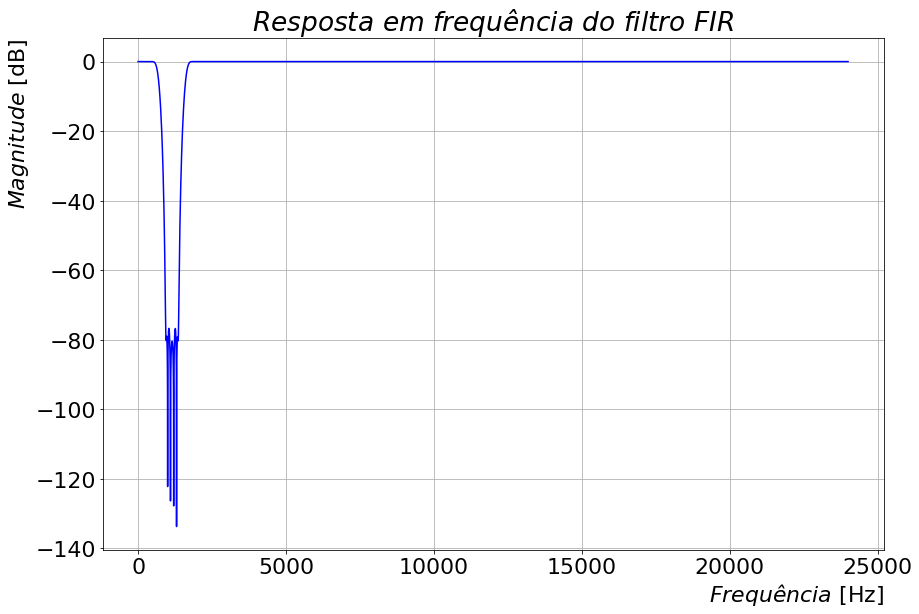

In [2]:
fs = 48e3;

worN = np.linspace(0, fs/2, 2**11);
worN = increase_range_steps(worN, 875, 1475, 2**11);

b = loadtxt('./pyFDA/coeficiente do filtro FIR rejeita faixa.csv', comments="#", delimiter=",", unpack=False);
fir_w, fir_response = signal.freqz(b, fs=fs, worN=worN);

plt.figure();

plt.plot(fir_w, 20*np.log10(abs(fir_response)), 'b');
plt.title(r'$Resposta \ em \ frequência \ do \ filtro \ FIR$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.grid();
plt.tight_layout();
plt.show();

Observa-se que os critérios pré-estabelecidos foram alcançados no filtro _FIR_ ao ampliar a resposta em frequência do filtro próximo a banda de rejeição na [Figura 4](#fig:4).

<a id='fig:4'></a>

<figcaption>
    <center>
        <b>Figura 4</b> - Magnificação da resposta em frequência do filtro <i>FIR</i> na banda de rejeição.
    </center>
</figcaption>

[comment]: # (Arquivos de imagens embutidos no jupyter notebook por meio de URL em base 64)

<center>
    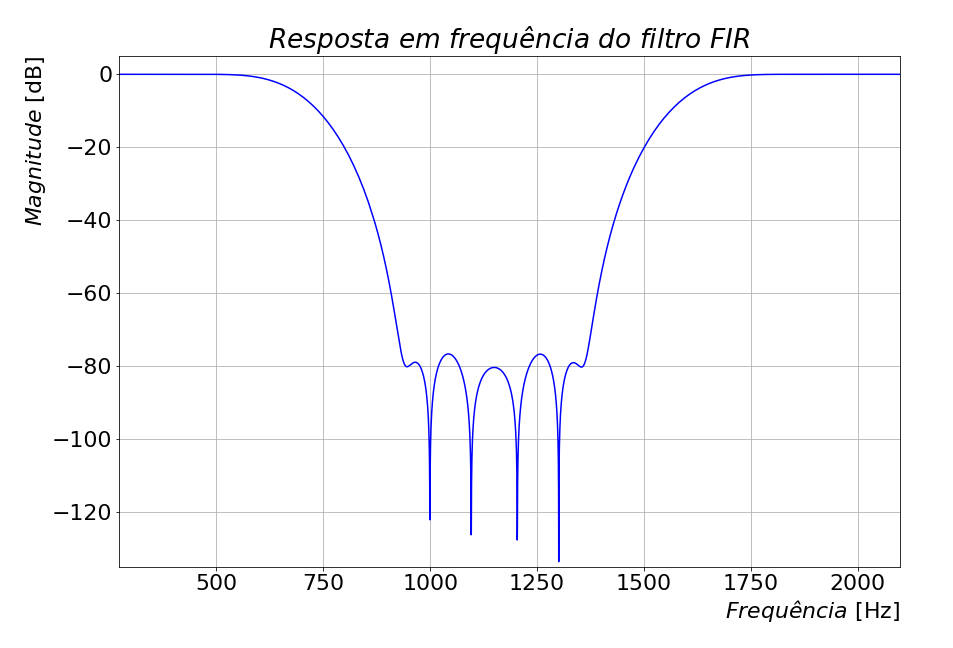
</center>

<figcaption>
    <center>
        <b>Fonte:</b> o autor.
    </center>
</figcaption>

## 3.2 Sinal filtrado por filtro _FIR_<a id='desenvolvimento:3-2'></a>

O arquivo de áudio `'audio-teste-ruido-gustavo.wav'` foi amostrado em uma frequência de 44,1 kHz, por isso deve ser reamostrado para 48 kHz antes da realização da filtragem para cumprir os requisitos do projeto. Dessarte, ele foi filtrado pelo filtro projetado no item 3. A seguir estão a gravação original e a filtrada, no que a segunda foi armazenada no arquivo `'audio-teste-ruido-gustavo-fir.wav'`.

In [3]:
fs, gravacao = wavfile.read('./áudios/audio-teste-ruido-gustavo.wav');
gravacao = gravacao.astype(float)/32768;
gravacao = signal.resample(gravacao, int(round((1/fs)*len(gravacao)*48e3)));
fs = int(48e3);

b = loadtxt('./pyFDA/coeficiente do filtro FIR rejeita faixa.csv', comments="#", delimiter=",", unpack=False);

gravacaofiltradafir = signal.lfilter(b, 1, gravacao);

print('Gravação original:');
display(Audio(gravacao, rate=fs, autoplay=False));

print('Gravação filtrada:');
display(Audio(gravacaofiltradafir, rate=fs, autoplay=False));

wavfile.write('./áudios/audio-teste-ruido-gustavo-fir.wav', fs,  gravacaofiltradafir);

Gravação original:


Gravação filtrada:


Afim de verificar a atuação do filtro _FIR_ na gravação de áudio, as imagens abaixo expõem a atenuação do sinal espúrio após a aplicação do filtro em relação ao original, em que a magnitude da sua frequência é reduzida significativamente. No entanto, o filtro atenua também outras frequência além da que o ruído ocupa, resultando em diminução da magnitude do sinal de interesse.

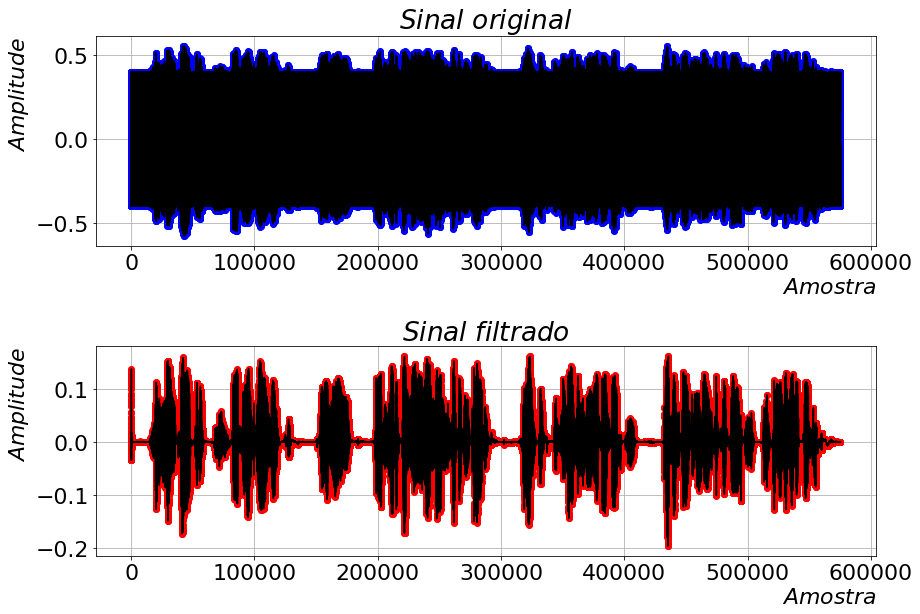

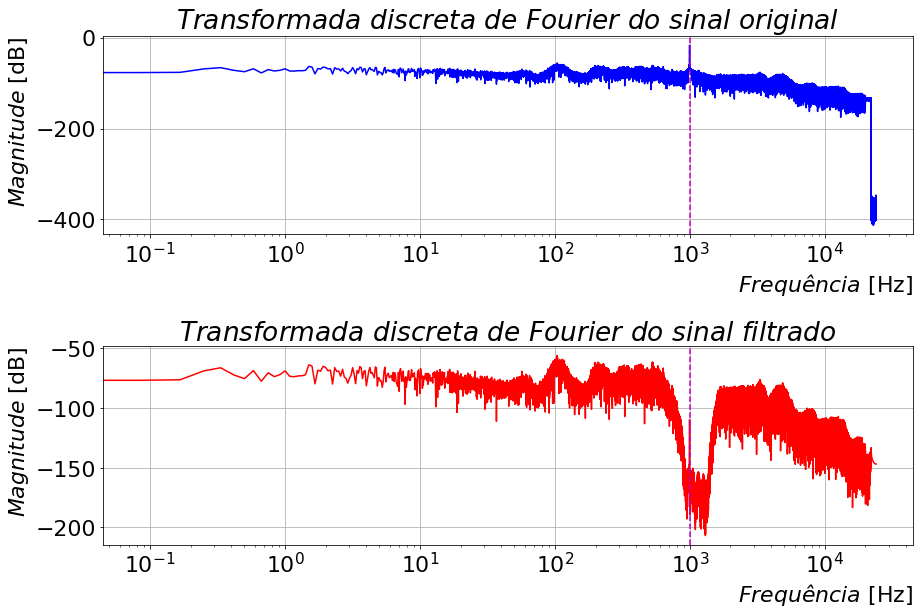

In [4]:
fs, gravacao = wavfile.read('./áudios/audio-teste-ruido-gustavo.wav');
gravacao = gravacao.astype(float)/32768;
gravacao = signal.resample(gravacao, int(round((1/fs)*len(gravacao)*48e3)));
fs = int(48e3);

b = loadtxt('./pyFDA/coeficiente do filtro FIR rejeita faixa.csv', comments="#", delimiter=",", unpack=False);
gravacaofiltradafir = signal.lfilter(b, 1, gravacao);

tranorig = np.fft.fftshift(np.fft.fft(gravacao)/len(gravacao));
tranorig = tranorig[int(len(gravacao)/2)::];
freqorig = np.fft.fftshift(np.fft.fftfreq(len(gravacao), d=1/fs));
freqorig = freqorig[int(len(gravacao)/2)::];

tranfiltfir = np.fft.fftshift(np.fft.fft(gravacaofiltradafir)/len(gravacaofiltradafir));
tranfiltfir = tranfiltfir[int(len(gravacaofiltradafir)/2)::];
freqfiltfir = np.fft.fftshift(np.fft.fftfreq(len(gravacaofiltradafir), d=1/fs));
freqfiltfir = freqfiltfir[int(len(gravacaofiltradafir)/2)::];

plt.figure();

plt.subplot(2,1,1);
plt.plot(gravacao, 'bo', gravacao, 'k');
plt.title(r'$Sinal \ original$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.subplot(2,1,2);
plt.plot(gravacaofiltradafir, 'ro', gravacaofiltradafir, 'k');
plt.title(r'$Sinal \ filtrado$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.figure();

plt.subplot(2,1,1);
plt.plot(freqorig, 20*np.log10(abs(tranorig)), 'b');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ do \ sinal \ original$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();

plt.subplots_adjust(hspace=1);

plt.subplot(2,1,2);
plt.plot(freqfiltfir, 20*np.log10(abs(tranfiltfir)), 'r');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ do \ sinal \ filtrado$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();
plt.show();

A frequência do sinal espúrio na imagem acima é demarcada por uma linha tracejada vertical.

# 4 Implementação do filtro _FIR_ em _hardware_<a id='desenvolvimento:4'></a>

Visto o projeto do filtro _FIR_ na [seção 3](#desenvolvimento:3), segue-se com a implementação do filtro em _hardware_. É utilizada a placa de desenvolvimento STM32F4 Discovery em conjunto da placa de áudio Wolfson Pi para fazer a transmissão, amostragem, filtragem e gravação de áudio de acordo com o diagrama da [Figura 5](#fig:5).

<a id='fig:5'></a>

<figcaption>
    <center>
        <b>Figura 5</b> - Diagrama de conexão entre computadores, Wolfson Pi e STM32F4 Discovery.
    </center>
</figcaption>

[comment]: # (Arquivos de imagens embutidos no jupyter notebook por meio de URL em base 64)

<center>
    
</center>

<figcaption>
    <center>
        <b>Fonte:</b> Fernando Santana Pacheco.
    </center>
</figcaption>

## 4.1 Filtro _FIR_ em ponto flutuante<a id='desenvolvimento:4-1'></a>

No programa OcenAudio foi gerado uma varredura de tons senodais de frequências de 1 Hz até 22050 Hz, onde sua gravação está localizada no arquivo `'sweep44-1kHz.wav'`. E depois foi filtrada pelo filtro _FIR_ implementado em ponto flutuante de 32 bits e gravado no arquivo `'sweep-saida-fir-f32.wav'`, apresentado na imagem abaixo.

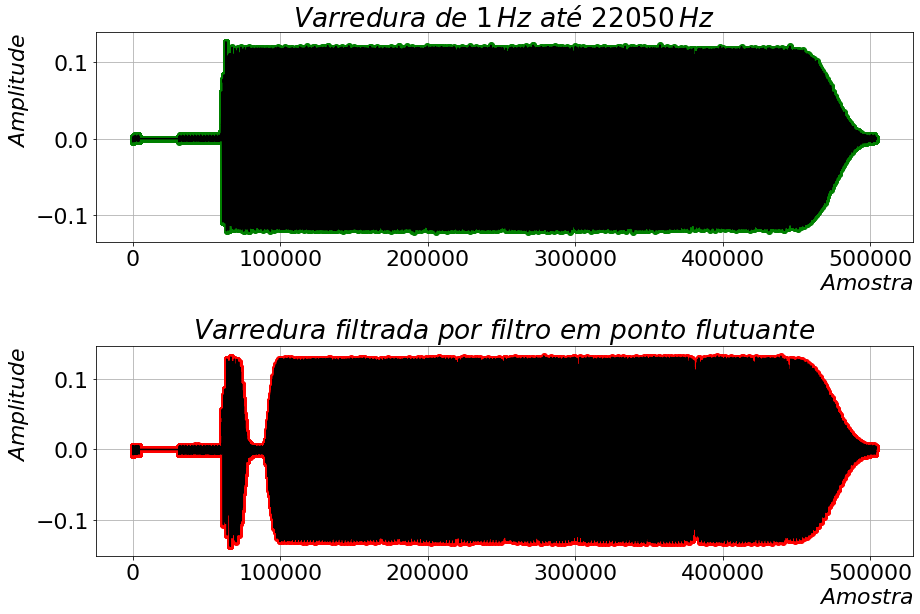

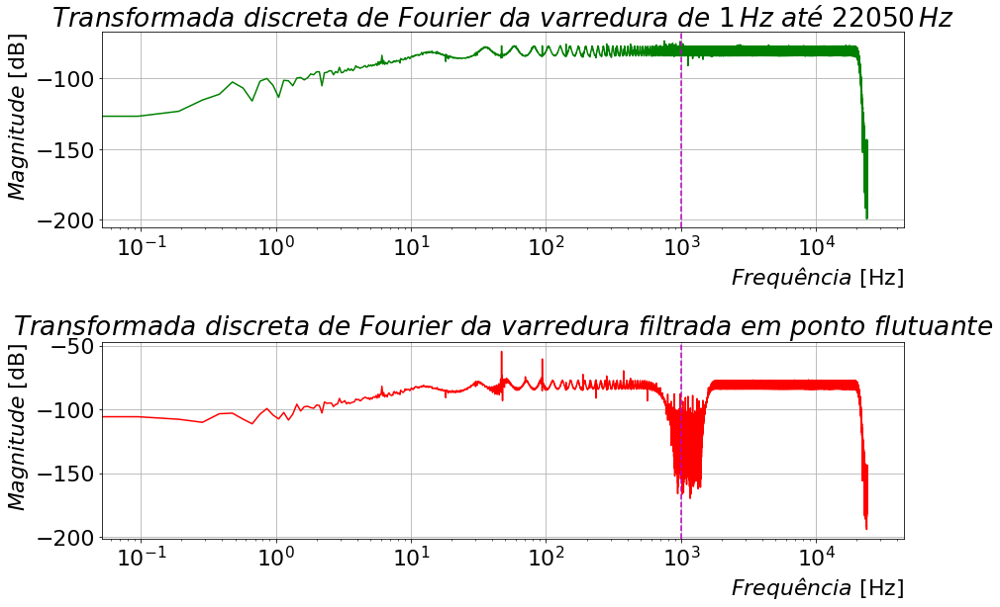

In [5]:
fs, audio = wavfile.read('./áudios/sweep-saida-fir-f32.wav');
sweep441 = audio.T[1][:int(len(audio.T[1])/3)].astype(float)/32768;
sweep441f32 = audio.T[0][:int(len(audio.T[0])/3)].astype(float)/32768;

transweep441 = np.fft.fftshift(np.fft.fft(sweep441)/len(sweep441));
transweep441 = transweep441[int(len(sweep441)/2)::];
freqsweep441 = np.fft.fftshift(np.fft.fftfreq(len(sweep441), d=1/fs));
freqsweep441 = freqsweep441[int(len(sweep441)/2)::];

transweep441f32 = np.fft.fftshift(np.fft.fft(sweep441f32)/len(sweep441f32));
transweep441f32 = transweep441f32[int(len(sweep441f32)/2)::];
freqsweep441f32 = np.fft.fftshift(np.fft.fftfreq(len(sweep441f32), d=1/fs));
freqsweep441f32 = freqsweep441f32[int(len(sweep441f32)/2)::];

plt.figure();

plt.subplot(2,1,1);
plt.plot(sweep441, 'go', sweep441, 'k');
plt.title(r'$Varredura \ de \ 1 \, Hz \ até \ 22050 \, Hz$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.subplot(2,1,2);
plt.plot(sweep441f32, 'ro', sweep441f32, 'k');
plt.title(r'$Varredura \ filtrada \ por \ filtro \ em \ ponto \ flutuante$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.figure();

plt.subplot(2,1,1);
plt.plot(freqsweep441, 20*np.log10(abs(transweep441)), 'g');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ da \ varredura \ de \ 1 \, Hz \ até \ 22050 \, Hz$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();

plt.subplots_adjust(hspace=1);

plt.subplot(2,1,2);
plt.plot(freqsweep441f32, 20*np.log10(abs(transweep441f32)), 'r');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ da \ varredura \ filtrada \ em \ ponto \ flutuante$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();
plt.show();

Vê-se que o filtro _FIR_ com coeficientes em ponto flutuante de 32 bits faz a filtragem com a mesma banda de rejeição que na resposta em frequência do filtro projetado. No entanto foi necessário diminuir a amplitude do sinal transmitido para evitar reflexões no processo de filtragem.

Seguidamente, o filtro é aplicado no áudio em que o sinal espúrio está presente, no que ele foi gravado no arquivo `'audio-teste-ruido-filtrado-fir-f32-gustavo.wav'` e teve o resultado abaixo. Infelizmente, devido à baixa amplitude do sinal e ao ambiente com presença de ruído, o áudio ainda possui interferência, apesar disso, o sinal espúrio original foi atenuado.

In [6]:
fs, gravacaof32 = wavfile.read('./áudios/audio-teste-ruido-filtrado-fir-f32-gustavo.wav');
gravacaof32_orig = gravacaof32.T[1].astype(float)/32768;
gravacaof32_filt = gravacaof32.T[0].astype(float)/32768;

print('Gravação original:');
display(Audio(gravacaof32_orig, rate=fs, autoplay=False));

print('Gravação filtrada pelo filtro FIR com coeficientes em ponto flutuante:');
display(Audio(gravacaof32_filt, rate=fs, autoplay=False));

Gravação original:


Gravação filtrada pelo filtro FIR com coeficientes em ponto flutuante:


As curvas do sinal original e do filtrado no tempo mostram que o sinal espúrio original foi atenuado, porém a presença de sinais de menor amplitude em outras frequências reafirmam a interferência externa na linha de transmissão entre o computador e a placa de desenvolvimento.

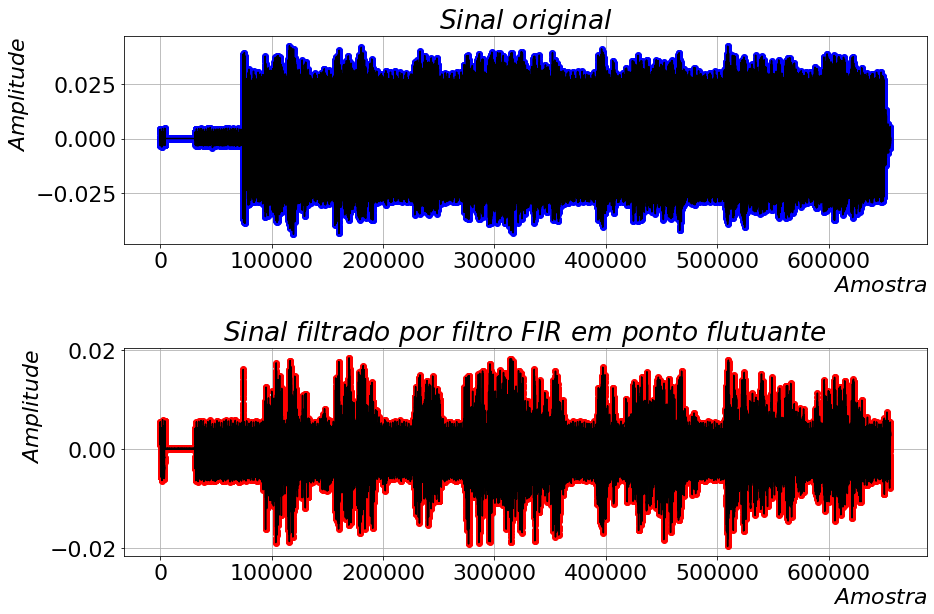

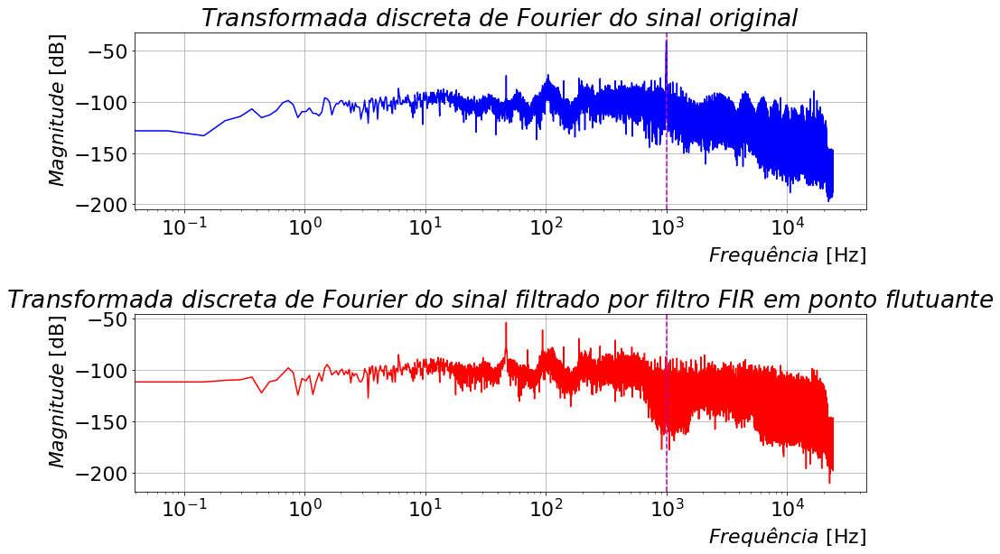

In [7]:
fs, gravacaof32 = wavfile.read('./áudios/audio-teste-ruido-filtrado-fir-f32-gustavo.wav');
gravacaof32_orig = gravacaof32.T[1].astype(float)/32768;
gravacaof32_filt = gravacaof32.T[0].astype(float)/32768;

tranorig = np.fft.fftshift(np.fft.fft(gravacaof32_orig)/len(gravacaof32_orig));
tranorig = tranorig[int(len(gravacaof32_orig)/2)::];
freqorig = np.fft.fftshift(np.fft.fftfreq(len(gravacaof32_orig), d=1/fs));
freqorig = freqorig[int(len(gravacaof32_orig)/2)::];

tranfiltfir = np.fft.fftshift(np.fft.fft(gravacaof32_filt)/len(gravacaof32_filt));
tranfiltfir = tranfiltfir[int(len(gravacaof32_filt)/2)::];
freqfiltfir = np.fft.fftshift(np.fft.fftfreq(len(gravacaof32_filt), d=1/fs));
freqfiltfir = freqfiltfir[int(len(gravacaof32_filt)/2)::];

plt.figure();

plt.subplot(2,1,1);
plt.plot(gravacaof32_orig, 'bo', gravacaof32_orig, 'k');
plt.title(r'$Sinal \ original$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.subplot(2,1,2);
plt.plot(gravacaof32_filt, 'ro', gravacaof32_filt, 'k');
plt.title(r'$Sinal \ filtrado \ por \ filtro \ FIR \ em \ ponto \ flutuante$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.figure();

plt.subplot(2,1,1);
plt.plot(freqorig, 20*np.log10(abs(tranorig)), 'b');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ do \ sinal \ original$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();

plt.subplots_adjust(hspace=1);

plt.subplot(2,1,2);
plt.plot(freqfiltfir, 20*np.log10(abs(tranfiltfir)), 'r');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ do \ sinal \ filtrado \ por \ filtro \ FIR \ em \ ponto \ flutuante$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();
plt.show();

Novamente se nota que a frequência do sinal espúrio é marcada por uma linha tracejada, onde originalmente ela tinha uma magnitude acima de -50 dB que foi atenuada para uma faixa de magnitude similar das frequências vizinhas.

## 4.2 Comparação entre o Filtro _FIR_ simulado e implementado em _hardware_<a id='desenvolvimento:4-2'></a>

A gravação filtrada pelo filtro _FIR_ na simulação não necessita de um ajuste para a sua amplitude para evitar reflexões. Deve-se ao fato do computador operar com pontos flutuantes de 64 bits ao invés dos de 32 bits disponíveis na placa de desenvolvimento. Também não existem outros ruídos consideráveis na simulação além do sinal espúrio.

## 4.3 Filtro _FIR_ em ponto fixo<a id='desenvolvimento:4-3'></a>

Após a obtenção dos coeficientes do filtro em ponto flutuante, eles são convertidos para ponto fixo. Dessa maneira a varredura de frequência é filtrada em _hardware_ com esses coeficientes, os quais são vistos no código e imagem abaixo. E o seu arquivo de áudio se encontra em `'sweep-saida-fir-q15.wav'`.

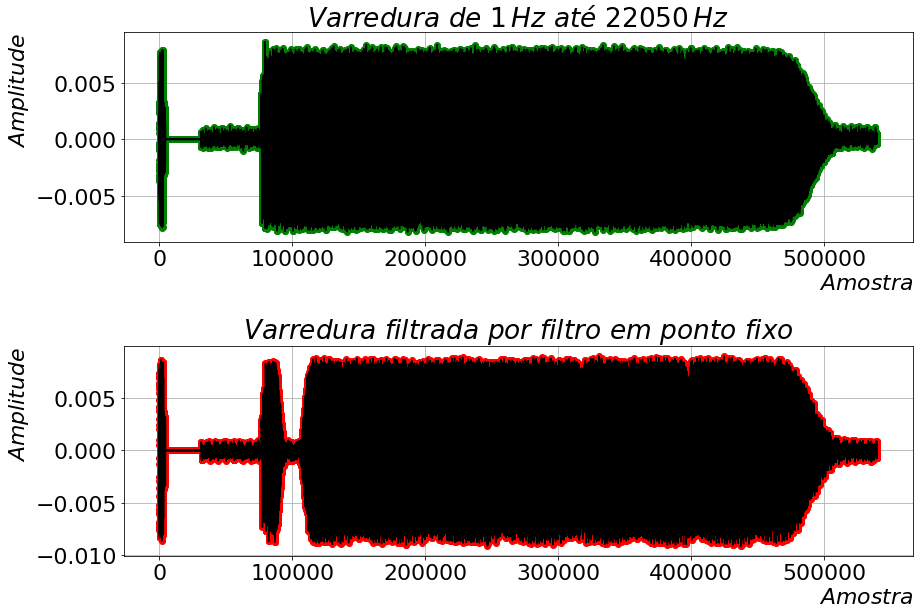

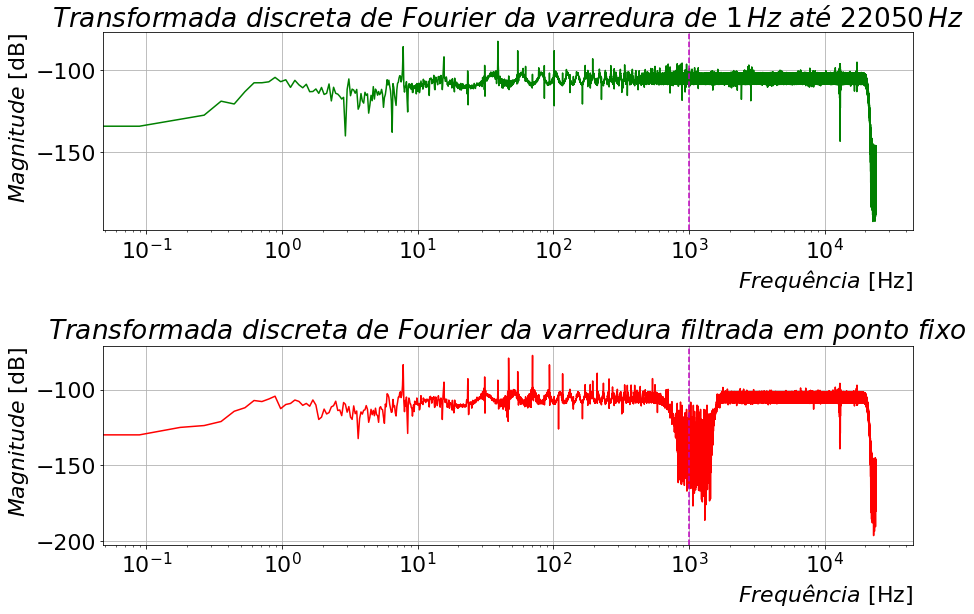

In [8]:
fs, audio = wavfile.read('./áudios/sweep-saida-fir-q15.wav');
sweep441 = audio.T[1][:int(len(audio.T[1])/2.8)].astype(float)/32768;
sweep441q15 = audio.T[0][:int(len(audio.T[0])/2.8)].astype(float)/32768;

transweep441 = np.fft.fftshift(np.fft.fft(sweep441)/len(sweep441));
transweep441 = transweep441[int(len(sweep441)/2)::];
freqsweep441 = np.fft.fftshift(np.fft.fftfreq(len(sweep441), d=1/fs));
freqsweep441 = freqsweep441[int(len(sweep441)/2)::];

transweep441q15 = np.fft.fftshift(np.fft.fft(sweep441q15)/len(sweep441q15));
transweep441q15 = transweep441q15[int(len(sweep441q15)/2)::];
freqsweep441q15 = np.fft.fftshift(np.fft.fftfreq(len(sweep441q15), d=1/fs));
freqsweep441q15 = freqsweep441q15[int(len(sweep441q15)/2)::];

plt.figure();

plt.subplot(2,1,1);
plt.plot(sweep441, 'go', sweep441, 'k');
plt.title(r'$Varredura \ de \ 1 \, Hz \ até \ 22050 \, Hz$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.subplot(2,1,2);
plt.plot(sweep441q15, 'ro', sweep441q15, 'k');
plt.title(r'$Varredura \ filtrada \ por \ filtro \ em \ ponto \ fixo$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.figure();

plt.subplot(2,1,1);
plt.plot(freqsweep441, 20*np.log10(abs(transweep441)), 'g');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ da \ varredura \ de \ 1 \, Hz \ até \ 22050 \, Hz$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();

plt.subplots_adjust(hspace=1);

plt.subplot(2,1,2);
plt.plot(freqsweep441q15, 20*np.log10(abs(transweep441q15)), 'r');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ da \ varredura \ filtrada \ em \ ponto \ fixo$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();
plt.show();

Observa-se que o filtro _FIR_ com coeficientes em ponto fixo faz a filtragem com a mesma banda de rejeição que na resposta em frequência do filtro em ponto flutuante. Porém foi necessário diminuir a amplitude ainda mais do sinal transmitido para evitar reflexões no processo de filtragem.

Em seguida, o filtro é aplicado no áudio em que o sinal espúrio está presente, no que ele foi gravado no arquivo `'audio-teste-ruido-filtrado-fir-q15-gustavo.wav'` e teve o resultado abaixo. Similar a [seção 4.1](#desenvolvimento:4-1) anterior, devido à baixa amplitude do sinal e ao ambiente com presença de ruído, o áudio ainda possui interferência, apesar disso, o sinal espúrio original foi atenuado.

In [9]:
fs, gravacaoq15 = wavfile.read('./áudios/audio-teste-ruido-filtrado-fir-f32-gustavo.wav');
gravacaoq15_orig = gravacaoq15.T[1].astype(float)/32768;
gravacaoq15_filt = gravacaoq15.T[0].astype(float)/32768;

print('Gravação original:');
display(Audio(gravacaoq15_orig, rate=fs, autoplay=False));

print('Gravação filtrada pelo filtro FIR com coeficientes em ponto fixo:');
display(Audio(gravacaoq15_filt, rate=fs, autoplay=False));

Gravação original:


Gravação filtrada pelo filtro FIR com coeficientes em ponto fixo:


As curvas do sinal original e do filtrado no tempo mostram que o sinal espúrio original foi atenuado, ainda que exista outros ruídos de diferentes frequências na gravação.

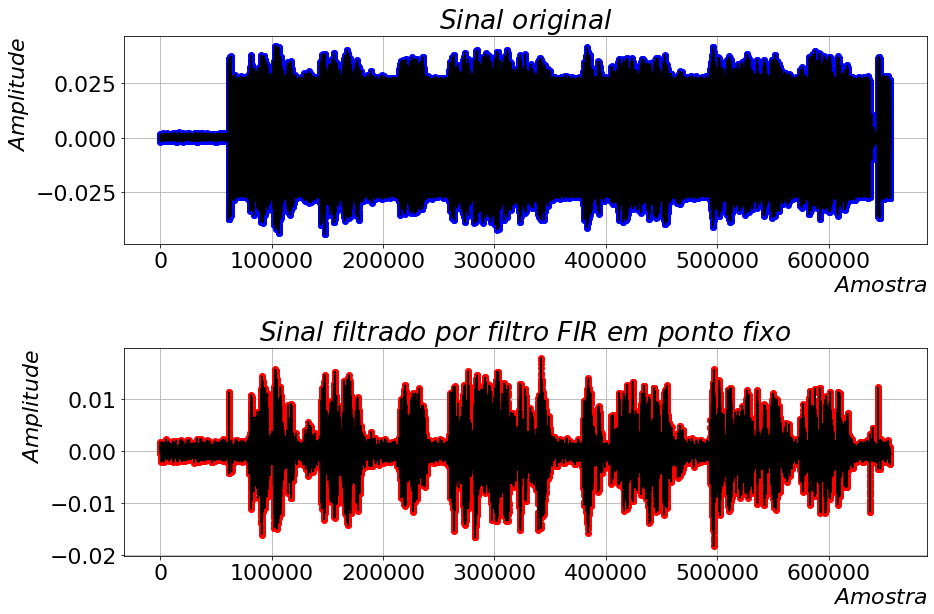

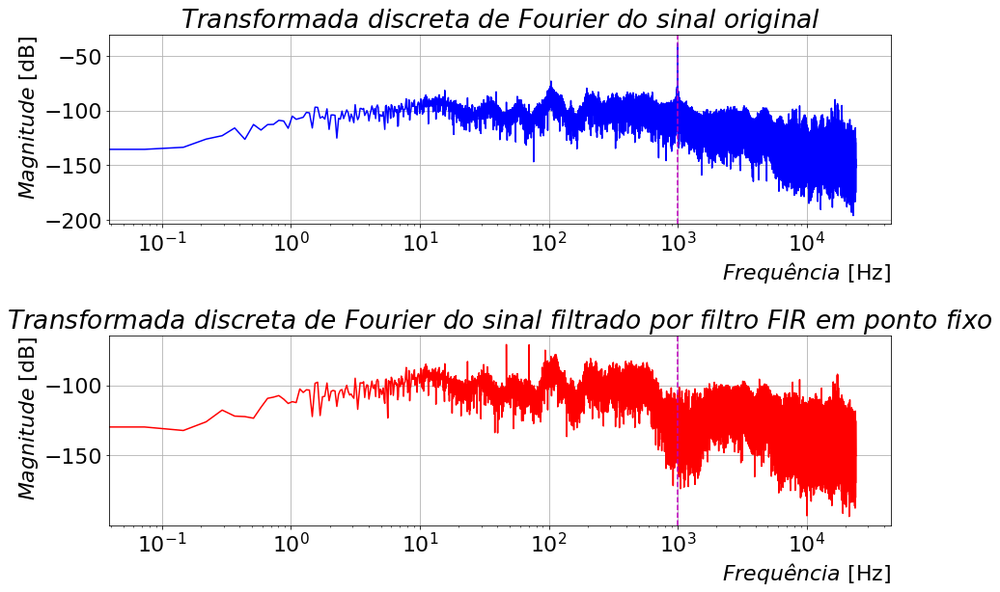

In [10]:
fs, gravacaoq15 = wavfile.read('./áudios/audio-teste-ruido-filtrado-fir-q15-gustavo.wav');
gravacaoq15_orig = gravacaoq15.T[1].astype(float)/32768;
gravacaoq15_filt = gravacaoq15.T[0].astype(float)/32768;

tranorig = np.fft.fftshift(np.fft.fft(gravacaoq15_orig)/len(gravacaoq15_orig));
tranorig = tranorig[int(len(gravacaoq15_orig)/2)::];
freqorig = np.fft.fftshift(np.fft.fftfreq(len(gravacaoq15_orig), d=1/fs));
freqorig = freqorig[int(len(gravacaoq15_orig)/2)::];

tranfiltfir = np.fft.fftshift(np.fft.fft(gravacaoq15_filt)/len(gravacaoq15_filt));
tranfiltfir = tranfiltfir[int(len(gravacaoq15_filt)/2)::];
freqfiltfir = np.fft.fftshift(np.fft.fftfreq(len(gravacaoq15_filt), d=1/fs));
freqfiltfir = freqfiltfir[int(len(gravacaoq15_filt)/2)::];

plt.figure();

plt.subplot(2,1,1);
plt.plot(gravacaoq15_orig, 'bo', gravacaoq15_orig, 'k');
plt.title(r'$Sinal \ original$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.subplot(2,1,2);
plt.plot(gravacaoq15_filt, 'ro', gravacaoq15_filt, 'k');
plt.title(r'$Sinal \ filtrado \ por \ filtro \ FIR \ em \ ponto \ fixo$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.figure();

plt.subplot(2,1,1);
plt.plot(freqorig, 20*np.log10(abs(tranorig)), 'b');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ do \ sinal \ original$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();

plt.subplots_adjust(hspace=1);

plt.subplot(2,1,2);
plt.plot(freqfiltfir, 20*np.log10(abs(tranfiltfir)), 'r');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ do \ sinal \ filtrado \ por \ filtro \ FIR \ em \ ponto \ fixo$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();
plt.show();

Mais uma vez, é denotado que a frequência do sinal espúrio é marcada por uma linha tracejada, onde originalmente ela tinha uma magnitude acima de -50 dB que foi atenuada para uma faixa de magnitude similar das frequências vizinhas.

## 4.4 Comparação entre o Filtro _FIR_ em ponto flutuante e em ponto fixo<a id='desenvolvimento:4-4'></a>

O filtro _FIR_ projetado em ponto flutuante tem menor propensão à reflexões do que o projetado em ponto fixo por ter uma maior faixa de valores quantizáveis. Isso permite a escolha de uma maior amplitude para a entrada e saída de sinais no processamento do filtro em ponto flutuante.

# 5 Projeto de um filtro _IIR_<a id='desenvolvimento:5'></a>

Por meio de uma breve análise dos diferentes tipos de filtros _IIR_ foram escolhidos os seguintes parâmetros para o filtro _IIR_ rejeita-faixa:

1. Tipo Elíptico.
2. Frequências de corte das bandas passantes de 975 e 1015 Hz.
3. Ondulação de 0,7 dB na frequência da banda passante.
4. Atenuação de 80 dB na frequência da banda de rejeição.
5. Frequência de amostragem de 48 kHz.
6. Ordem de 8 do filtro.

Em que o tipo de filtro Elíptico, ou de Cauer, foi selecionado por promover uma rápida transição entre as bandas passantes e a banda de rejeição quando comparado aos tipos de filtros Butterworth, Chebyshev-I e Chebyshev-II [[1]](#referencias:1). Isso permite uma menor largura de banda necessária para sua implementação. 

## 5.1 Gráfico da magnitude da resposta em frequência do filtro _IIR_ projetado<a id='desenvolvimento:5-1'></a>

No código e figura abaixo está a resposta em frequência do filtro projetado no item anterior. Ele deve ser implementado em seções de segunda ordem, ou biquadradas, para evitar a instabilidade numérica no seus resultados como visto na referência da função [sosfilt](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.sosfilt.html), em que os polos ao entorno da circunferência unitária no domínio discreto são empurrados para fora dele. Isso implica na instabilidade do filtro.

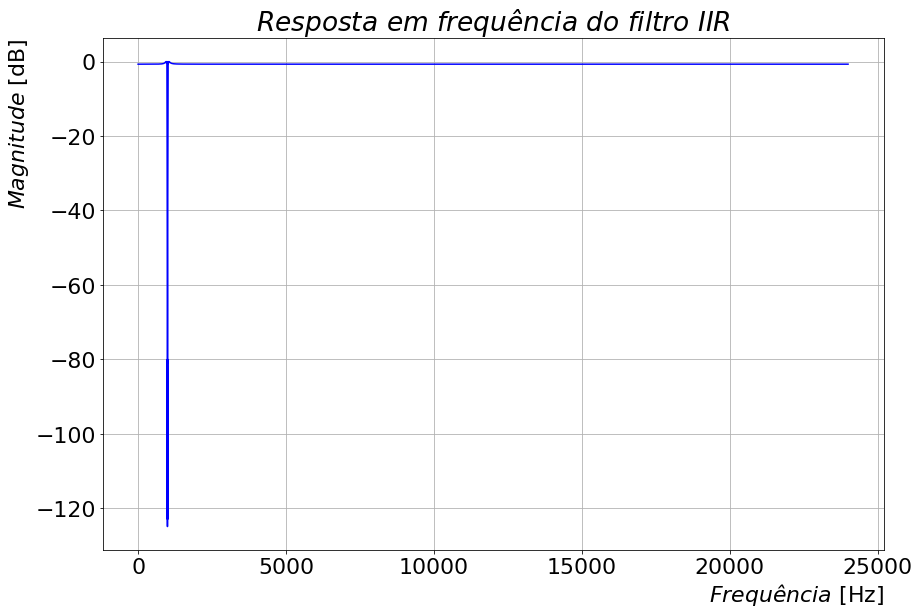

In [11]:
fs = 48e3;

worN = np.linspace(0, fs/2, 2**11);
worN = increase_range_steps(worN, 975, 1015, 2**11);

# Ordem de 4 seções biquadradas devem usadas para filtros passa-faixa e rejeita-faixa.
sosiir = signal.ellip(4, 0.7, 80, [975, 1015], btype='bandstop', output='sos', fs=fs);
iir_w, iir_response = signal.sosfreqz(sosiir, fs=fs, worN=worN);

plt.figure();

plt.plot(iir_w, 20*np.log10(abs(iir_response)), 'b');
plt.title(r'$Resposta \ em \ frequência \ do \ filtro \ IIR$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.grid();
plt.tight_layout();
plt.show();

Verifica-se que os requisitos foram alcançados no filtro _IIR_ ao ampliar a resposta em frequência do filtro próximo a banda de rejeição na [Figura 6](#fig:6).

<a id='fig:6'></a>

<figcaption>
    <center>
        <b>Figura 6</b> - Magnificação da resposta em frequência do filtro <i>IIR</i> na banda de rejeição.
    </center>
</figcaption>

[comment]: # (Arquivos de imagens embutidos no jupyter notebook por meio de URL em base 64)

<center>
    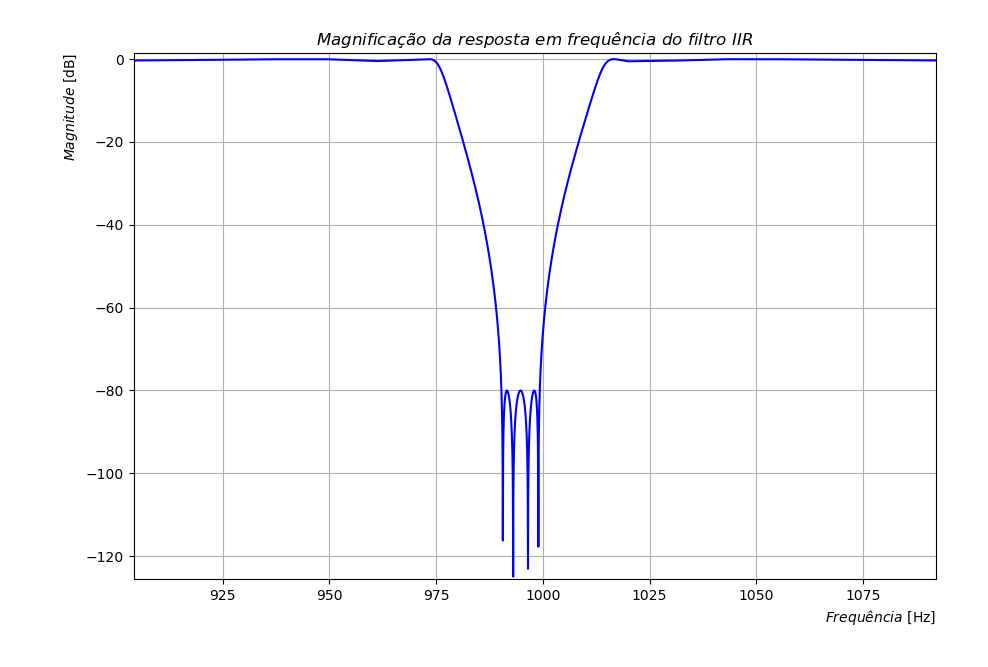
</center>

<figcaption>
    <center>
        <b>Fonte:</b> o autor.
    </center>
</figcaption>

## 5.2 Sinal filtrado por filtro _IIR_<a id='desenvolvimento:5-2'></a>

O arquivo de áudio `'audio-teste-ruido-gustavo.wav'` foi reamostrado como na [seção 3.2](#desenvolvimento:3-2) e filtrado pelo filtro projetado no item 5. A seguir estão a gravação original e a filtrada, no que a segunda foi armazenada no arquivo `'audio-teste-ruido-gustavo-iir.wav'`.

In [12]:
fs, gravacao = wavfile.read('./áudios/audio-teste-ruido-gustavo.wav');
gravacao = gravacao.astype(float)/32768;
gravacao = signal.resample(gravacao, int(round((1/fs)*len(gravacao)*48e3)));
fs = int(48e3);

sosiir = signal.ellip(4, 0.7, 80, [975, 1015], btype='bandstop', output='sos', fs=fs);

gravacaofiltradaiir = signal.sosfilt(sosiir, gravacao);

print('Gravação original:');
display(Audio(gravacao, rate=fs, autoplay=False));

print('Gravação filtrada:');
display(Audio(gravacaofiltradaiir, rate=fs, autoplay=False));

wavfile.write('./áudios/audio-teste-ruido-gustavo-iir.wav', fs,  gravacaofiltradaiir);

Gravação original:


Gravação filtrada:


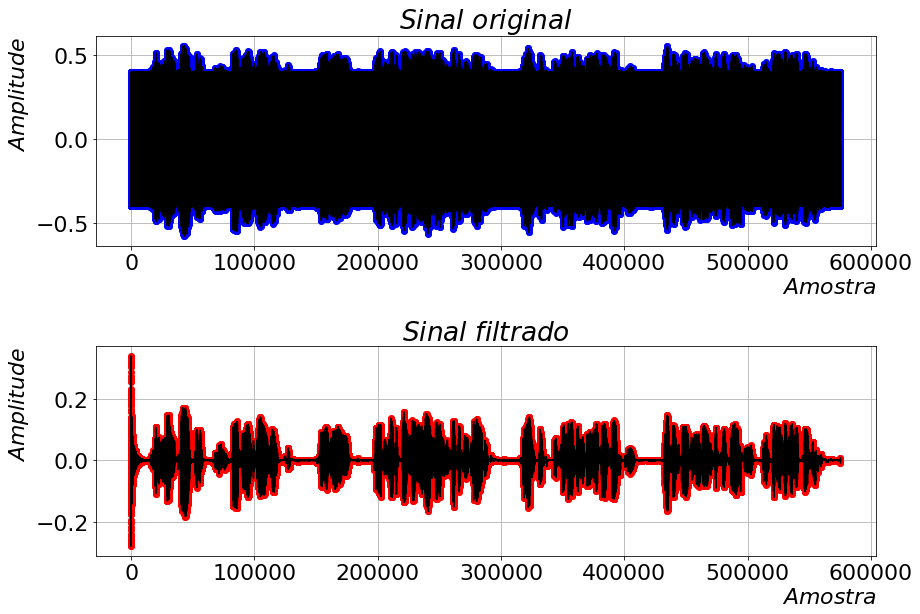

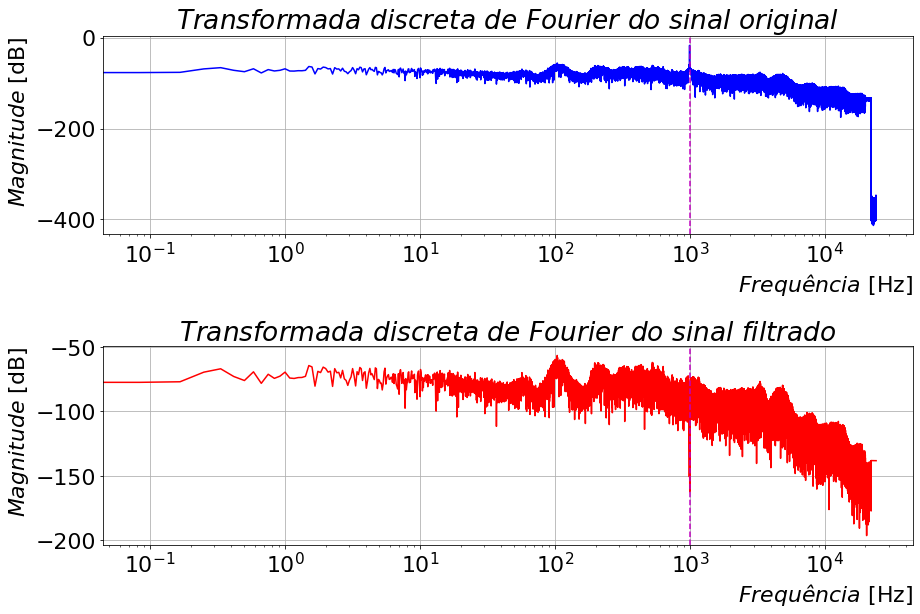

In [13]:
fs, gravacao = wavfile.read('./áudios/audio-teste-ruido-gustavo.wav');
gravacao = gravacao.astype(float)/32768;
gravacao = signal.resample(gravacao, int(round((1/fs)*len(gravacao)*48e3)));
fs = int(48e3);

sosiir = signal.ellip(4, 0.7, 80, [975/(fs/2), 1015/(fs/2)], btype='bandstop', output='sos');
gravacaofiltradaiir = signal.sosfilt(sosiir, gravacao);

tranorig = np.fft.fftshift(np.fft.fft(gravacao)/len(gravacao));
tranorig = tranorig[int(len(gravacao)/2)::];
freqorig = np.fft.fftshift(np.fft.fftfreq(len(gravacao), d=1/fs));
freqorig = freqorig[int(len(gravacao)/2)::];

tranfiltiir = np.fft.fftshift(np.fft.fft(gravacaofiltradaiir)/len(gravacaofiltradaiir));
tranfiltiir = tranfiltiir[int(len(gravacaofiltradaiir)/2)::];
freqfiltiir = np.fft.fftshift(np.fft.fftfreq(len(gravacaofiltradaiir), d=1/fs));
freqfiltiir = freqfiltiir[int(len(gravacaofiltradaiir)/2)::];

plt.figure();

plt.subplot(2,1,1);
plt.plot(gravacao, 'bo', gravacao, 'k');
plt.title(r'$Sinal \ original$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.subplot(2,1,2);
plt.plot(gravacaofiltradaiir, 'ro', gravacaofiltradaiir, 'k');
plt.title(r'$Sinal \ filtrado$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.figure();

plt.subplot(2,1,1);
plt.plot(freqorig, 20*np.log10(abs(tranorig)), 'b');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ do \ sinal \ original$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();

plt.subplots_adjust(hspace=1);

plt.subplot(2,1,2);
plt.plot(freqfiltiir, 20*np.log10(abs(tranfiltiir)), 'r');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ do \ sinal \ filtrado$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();
plt.show();

Similar a [seção 3.2](#desenvolvimento:3-2) a frequência do sinal espúrio na imagem acima também é demarcada por uma linha tracejada vertical.

# 6 Implementação do filtro _IIR_ em _hardware_<a id='desenvolvimento:6'></a>

Visto o projeto do filtro _IIR_ na [seção 5](#desenvolvimento:5), é dado ínicio à implementação do filtro em _hardware_. De mesma maneira que na [seção 4](#desenvolvimento:4) é utilizada a placa de desenvolvimento STM32F4 Discovery em conjunto da placa de áudio Wolfson Pi para fazer a transmissão, amostragem, filtragem e gravação de áudio.

Assim, no programa OcenAudio foi gerado uma varredura de tons senodais de frequências de 1 Hz até 24000 Hz, onde sua gravação está localizada no arquivo `'sweep.wav'`. E depois foi filtrada pelo filtro _IIR_ implementado em ponto flutuante de 32 bits e gravado no arquivo `'sweep-saida-iir.wav'`, apresentado na imagem abaixo.

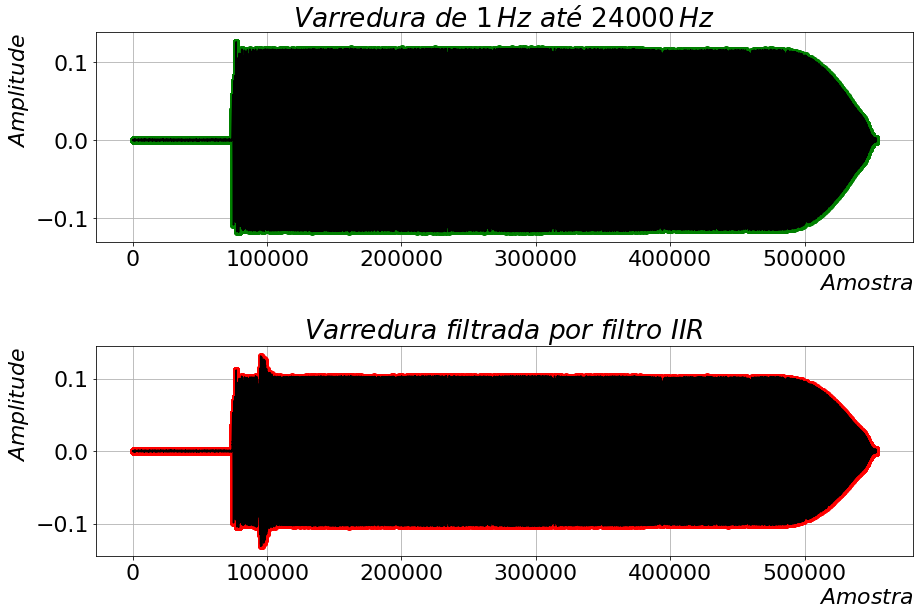

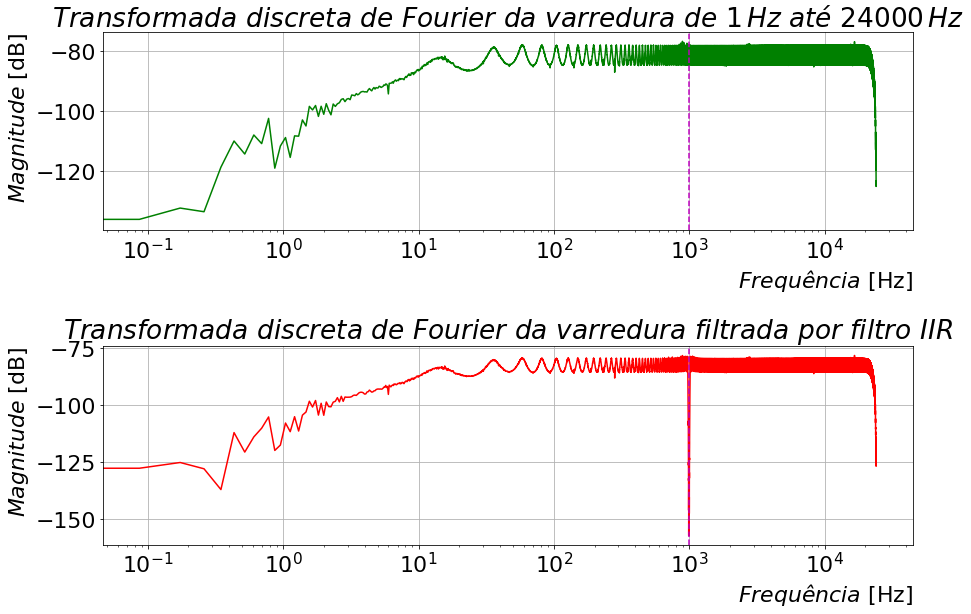

In [14]:
fs, audio = wavfile.read('./áudios/sweep-saida-iir.wav');
sweep48 = audio.T[1][:int(len(audio.T[1])/2.77)].astype(float)/32768;
sweep48iir = audio.T[0][:int(len(audio.T[0])/2.77)].astype(float)/32768;

transweep48 = np.fft.fftshift(np.fft.fft(sweep48)/len(sweep48));
transweep48 = transweep48[int(len(sweep48)/2)::];
freqsweep48 = np.fft.fftshift(np.fft.fftfreq(len(sweep48), d=1/fs));
freqsweep48 = freqsweep48[int(len(sweep48)/2)::];

transweep48iir = np.fft.fftshift(np.fft.fft(sweep48iir)/len(sweep48iir));
transweep48iir = transweep48iir[int(len(sweep48iir)/2)::];
freqsweep48iir = np.fft.fftshift(np.fft.fftfreq(len(sweep48iir), d=1/fs));
freqsweep48iir = freqsweep48iir[int(len(sweep48iir)/2)::];

plt.figure();

plt.subplot(2,1,1);
plt.plot(sweep48, 'go', sweep48, 'k');
plt.title(r'$Varredura \ de \ 1 \, Hz \ até \ 24000 \, Hz$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.subplot(2,1,2);
plt.plot(sweep48iir, 'ro', sweep48iir, 'k');
plt.title(r'$Varredura \ filtrada \ por \ filtro \ IIR$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.figure();

plt.subplot(2,1,1);
plt.plot(freqsweep48, 20*np.log10(abs(transweep48)), 'g');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ da \ varredura \ de \ 1 \, Hz \ até \ 24000 \, Hz$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();

plt.subplots_adjust(hspace=1);

plt.subplot(2,1,2);
plt.plot(freqsweep48iir, 20*np.log10(abs(transweep48iir)), 'r');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ da \ varredura \ filtrada \ por \ filtro \ IIR$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();
plt.show();

Verifica-se que a magnitude no entorno da frequência de 995 Hz é atenuada, próxima a linha tracejada na imagem acima.

Percebe-se que o filtro _IIR_ faz a filtragem com a mesma banda de rejeição que na resposta em frequência do filtro projetado. No entanto foi necessário diminuir a amplitude do sinal transmitido para evitar reflexões no processo de filtragem.

Na sequência, o filtro é aplicado no áudio em que o sinal espúrio está presente, no que ele foi gravado no arquivo `'audio-teste-ruido-filtrado-iir-gustavo.wav'` e teve o resultado abaixo.

In [15]:
fs, gravacaoiir = wavfile.read('./áudios/audio-teste-ruido-filtrado-iir-gustavo.wav');
gravacaoiir_orig = gravacaoiir.T[1].astype(float)/32768;
gravacaoiir_filt = gravacaoiir.T[0].astype(float)/32768;

print('Gravação original:');
display(Audio(gravacaoiir_orig, rate=fs, autoplay=False));

print('Gravação filtrada pelo filtro IIR:');
display(Audio(gravacaoiir_filt, rate=fs, autoplay=False));

Gravação original:


Gravação filtrada pelo filtro IIR:


As curvas do sinal original e do filtrado no tempo abaixo mostram que o sinal espúrio foi atenuado. Porém o filtro ainda afeta uma largura de banda maior do que o necessário.

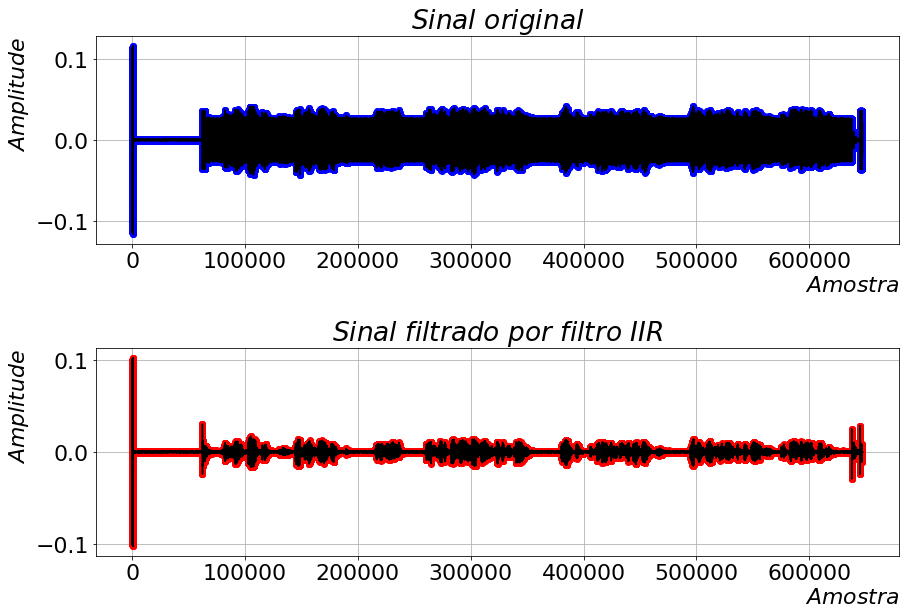

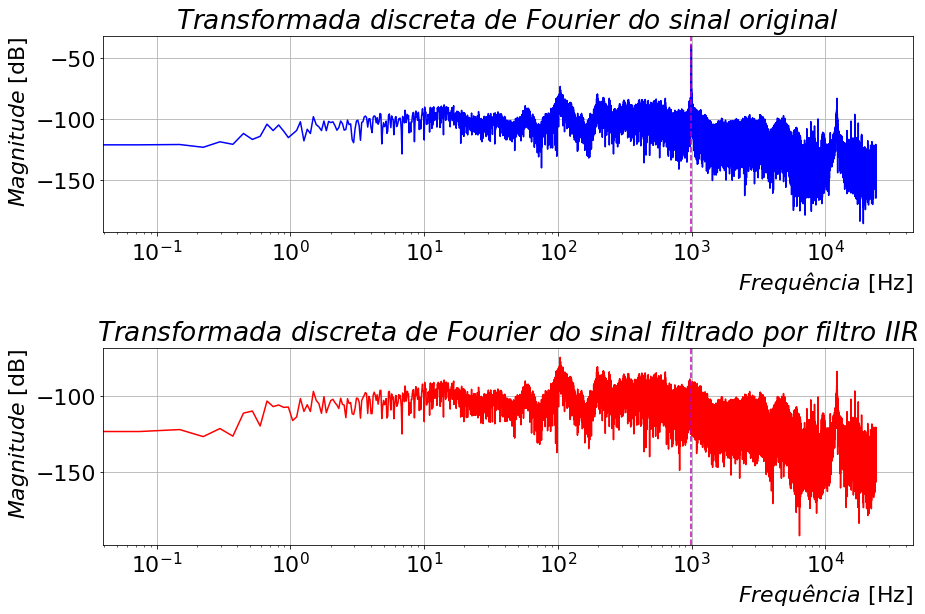

In [16]:
fs, gravacaoiir = wavfile.read('./áudios/audio-teste-ruido-filtrado-iir-gustavo.wav');
gravacaoiir_orig = gravacaoiir.T[1].astype(float)/32768;
gravacaoiir_filt = gravacaoiir.T[0].astype(float)/32768;

tranorig = np.fft.fftshift(np.fft.fft(gravacaoiir_orig)/len(gravacaoiir_orig));
tranorig = tranorig[int(len(gravacaoiir_orig)/2)::];
freqorig = np.fft.fftshift(np.fft.fftfreq(len(gravacaoiir_orig), d=1/fs));
freqorig = freqorig[int(len(gravacaoiir_orig)/2)::];

tranfiltiir = np.fft.fftshift(np.fft.fft(gravacaoiir_filt)/len(gravacaoiir_filt));
tranfiltiir = tranfiltiir[int(len(gravacaoiir_filt)/2)::];
freqfiltiir = np.fft.fftshift(np.fft.fftfreq(len(gravacaoiir_filt), d=1/fs));
freqfiltiir = freqfiltiir[int(len(gravacaoiir_filt)/2)::];

plt.figure();

plt.subplot(2,1,1);
plt.plot(gravacaoiir_orig, 'bo', gravacaoiir_orig, 'k');
plt.title(r'$Sinal \ original$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.subplot(2,1,2);
plt.plot(gravacaoiir_filt, 'ro', gravacaoiir_filt, 'k');
plt.title(r'$Sinal \ filtrado \ por \ filtro \ IIR$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.figure();

plt.subplot(2,1,1);
plt.plot(freqorig, 20*np.log10(abs(tranorig)), 'b');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ do \ sinal \ original$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();

plt.subplots_adjust(hspace=1);

plt.subplot(2,1,2);
plt.plot(freqfiltiir, 20*np.log10(abs(tranfiltiir)), 'r');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ do \ sinal \ filtrado \ por \ filtro \ IIR$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();
plt.show();

# 7 Projeto de um filtro _notch_<a id='desenvolvimento:7'></a>

Foram escolhidos os seguintes parâmetros para o filtro _notch_ rejeita-faixa com realimentação [[2]](#referencias:2):

1. Frequência de 995 Hz.
2. Coeficiente $\alpha$ igual a 1.
3. Coeficiente $\rho$ igual a 0,996.
4. Frequência de amostragem de 48 kHz.

Esse filtro é diferente da estrutura do _notch_ usada pela biblioteca `scipy`, por incluir a realimentação no filtro, a sua função de transferência é alterada. Nisso, a largura de banda do filtro diminui e ele torna-se mais seletivo.

## 7.1 Gráfico da magnitude da resposta em frequência do filtro _notch_ projetado<a id='desenvolvimento:7-1'></a>

No código e na figura abaixo está a resposta em frequência do filtro projetado no item anterior.

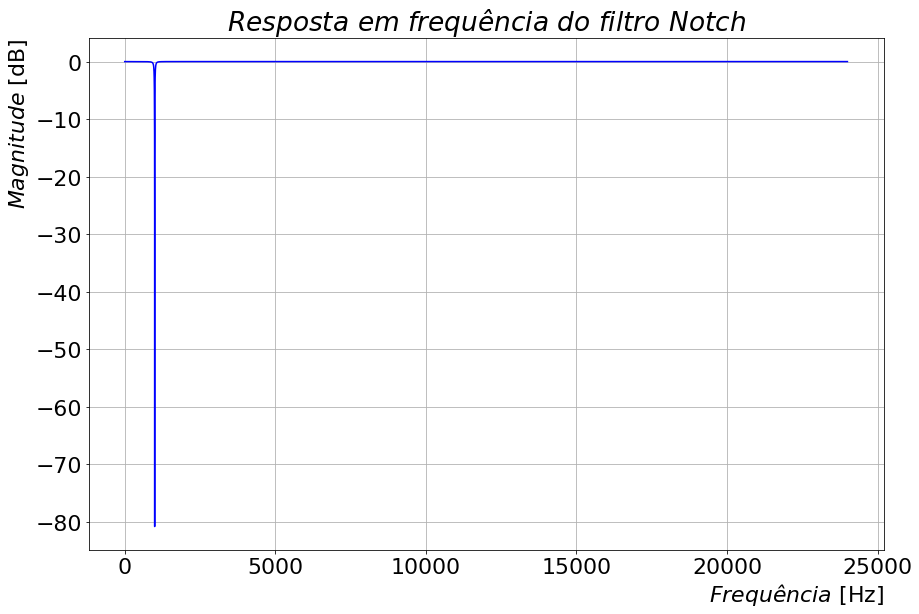

In [17]:
fs = 48e3;

worN = np.linspace(0, fs/2, 2**13);
worN = increase_range_steps(worN, 990, 1010, 2**13);

coeff_a = 1;
p = 0.996;
wnotch = 995.*2*math.pi/fs;
b = [1, -2*math.cos(wnotch), 1];
b = [coeff*(1+coeff_a) for coeff in b];
a = [(1+coeff_a), -2*(coeff_a+p)*math.cos(wnotch), ((p**2)+coeff_a)];
notch_w, notch_response = signal.freqz(b, a, fs=fs, worN=worN);

plt.figure();

plt.plot(notch_w, 20*np.log10(abs(notch_response)), 'b');
plt.title(r'$Resposta \ em \ frequência \ do \ filtro \ Notch$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.grid();
plt.tight_layout();
plt.show();

Nota-se que o requisito de frequência foi alcançado no filtro _notch_ ao ampliar a resposta em frequência do filtro próximo a frequência de rejeição na [Figura 7](#fig:7).

<a id='fig:7'></a>

<figcaption>
    <center>
        <b>Figura 7</b> - Magnificação da resposta em frequência do filtro <i>notch</i> na frequência de rejeição.
    </center>
</figcaption>

[comment]: # (Arquivos de imagens embutidos no jupyter notebook por meio de URL em base 64)

<center>
    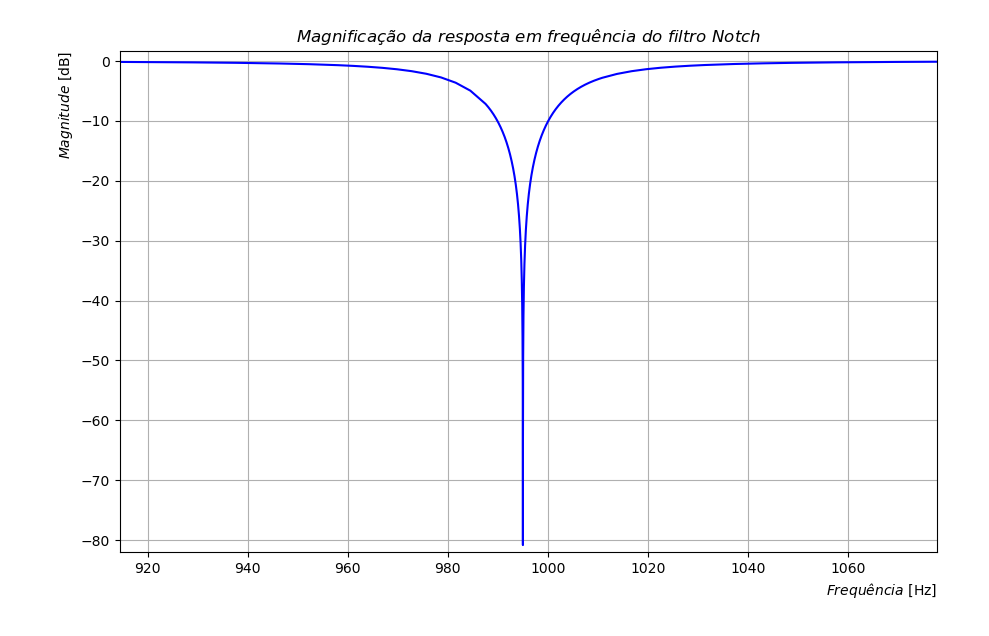
</center>

<figcaption>
    <center>
        <b>Fonte:</b> o autor.
    </center>
</figcaption>

## 7.2 Sinal filtrado por filtro _notch_<a id='desenvolvimento:7-2'></a>

O arquivo de áudio `'audio-teste-ruido-gustavo.wav'` foi novamente reamostrado como na [seção 3.2](#desenvolvimento:3-2) e filtrado pelo filtro projetado no item 7. A seguir estão a gravação original e a filtrada, no que a segunda foi armazenada no arquivo `'audio-teste-ruido-gustavo-notch.wav'`.

In [18]:
fs, gravacao = wavfile.read('./áudios/audio-teste-ruido-gustavo.wav');
gravacao = gravacao.astype(float)/32768;
gravacao = signal.resample(gravacao, int(round((1/fs)*len(gravacao)*48e3)));
fs = int(48e3);

coeff_a = 1;
p = 0.996;
wnotch = 995.*math.pi/(fs/2);
b = [1, -2*math.cos(wnotch), 1];
b = [coeff*(1+coeff_a) for coeff in b];
a = [(1+coeff_a), -2*(coeff_a+p)*math.cos(wnotch), ((p**2)+coeff_a)];
gravacaofiltradanotch = signal.lfilter(b, a, gravacao);

print('Gravação original:');
display(Audio(gravacao, rate=fs, autoplay=False));

print('Gravação filtrada:');
display(Audio(gravacaofiltradanotch, rate=fs, autoplay=False));

wavfile.write('./áudios/audio-teste-ruido-gustavo-notch.wav', fs,  gravacaofiltradanotch);

Gravação original:


Gravação filtrada:


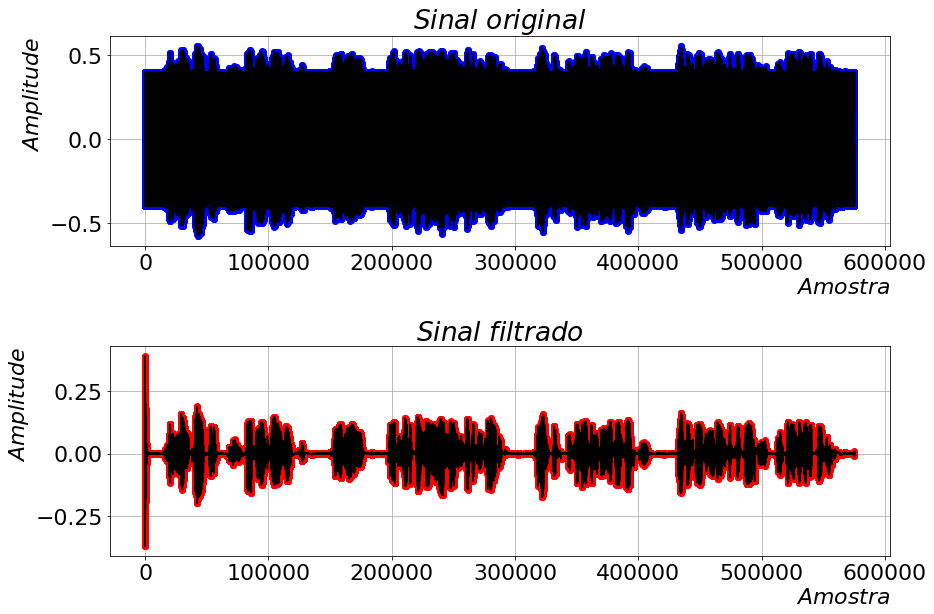

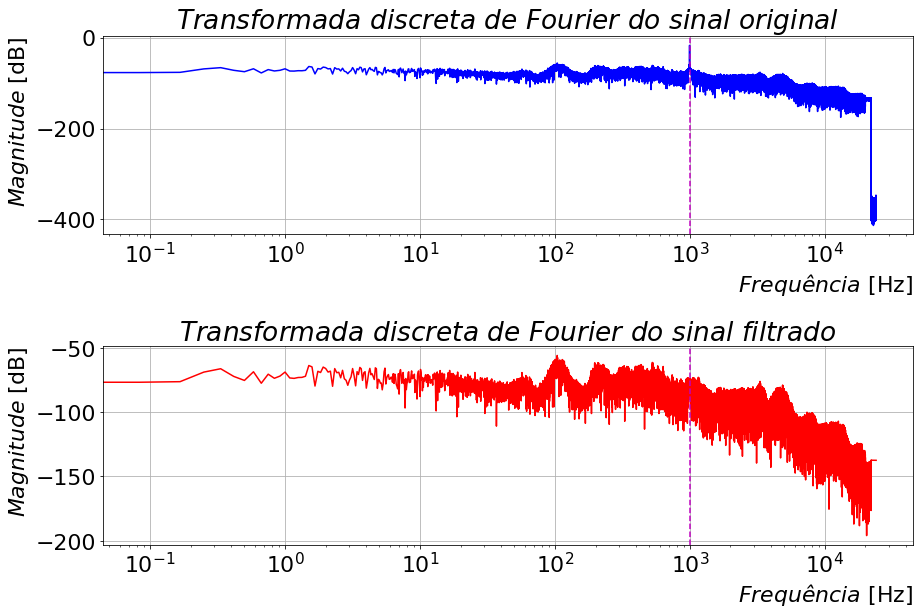

In [19]:
fs, gravacao = wavfile.read('./áudios/audio-teste-ruido-gustavo.wav');
gravacao = gravacao.astype(float)/32768;
gravacao = signal.resample(gravacao, int(round((1/fs)*len(gravacao)*48e3)));
fs = int(48e3);

coeff_a = 1;
p = 0.996;
wnotch = 995.*math.pi/(fs/2);
b = [1, -2*math.cos(wnotch), 1];
b = [coeff*(1+coeff_a) for coeff in b];
a = [(1+coeff_a), -2*(coeff_a+p)*math.cos(wnotch), ((p**2)+coeff_a)];
gravacaofiltradanotch = signal.lfilter(b, a, gravacao);

tranorig = np.fft.fftshift(np.fft.fft(gravacao)/len(gravacao));
tranorig = tranorig[int(len(gravacao)/2)::];
freqorig = np.fft.fftshift(np.fft.fftfreq(len(gravacao), d=1/fs));
freqorig = freqorig[int(len(gravacao)/2)::];

tranfiltnotch = np.fft.fftshift(np.fft.fft(gravacaofiltradanotch)/len(gravacaofiltradanotch));
tranfiltnotch = tranfiltnotch[int(len(gravacaofiltradanotch)/2)::];
freqfiltnotch = np.fft.fftshift(np.fft.fftfreq(len(gravacaofiltradanotch), d=1/fs));
freqfiltnotch = freqfiltnotch[int(len(gravacaofiltradanotch)/2)::];

plt.figure();

plt.subplot(2,1,1);
plt.plot(gravacao, 'bo', gravacao, 'k');
plt.title(r'$Sinal \ original$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.subplot(2,1,2);
plt.plot(gravacaofiltradanotch, 'ro', gravacaofiltradanotch, 'k');
plt.title(r'$Sinal \ filtrado$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.figure();

plt.subplot(2,1,1);
plt.plot(freqorig, 20*np.log10(abs(tranorig)), 'b');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ do \ sinal \ original$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();

plt.subplots_adjust(hspace=1);

plt.subplot(2,1,2);
plt.plot(freqfiltnotch, 20*np.log10(abs(tranfiltnotch)), 'r');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ do \ sinal \ filtrado$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();
plt.show();

Similar a [seção 3.2](#desenvolvimento:3-2) e a [seção 5.2](#desenvolvimento:5-2) a frequência do sinal espúrio na imagem acima também é demarcada por uma linha tracejada vertical.

# 8 Implementação do filtro _notch_ em _hardware_<a id='desenvolvimento:8'></a>

Visto o projeto do filtro _notch_ na [seção 7](#desenvolvimento:7), é dado ínico à implementação do filtro em _hardware_. Igual a [seção 4](#desenvolvimento:4) e a [seção 6](#desenvolvimento:6) é utilizada a placa de desenvolvimento STM32F4 Discovery em conjunto da placa de áudio Wolfson Pi para fazer a transmissão, amostragem, filtragem e gravação de áudio.

Foi usada a mesma varredura de tons senodais de frequências de 1 Hz até 24000 Hz geradas na [seção 6](#desenvolvimento:6), proveniente do arquivo`'sweep.wav'`. E depois foi filtrada pelo filtro _notch_ implementado em ponto flutuante de 32 bits e gravado no arquivo `'sweep-saida-notch.wav'`, apresentado na imagem abaixo.

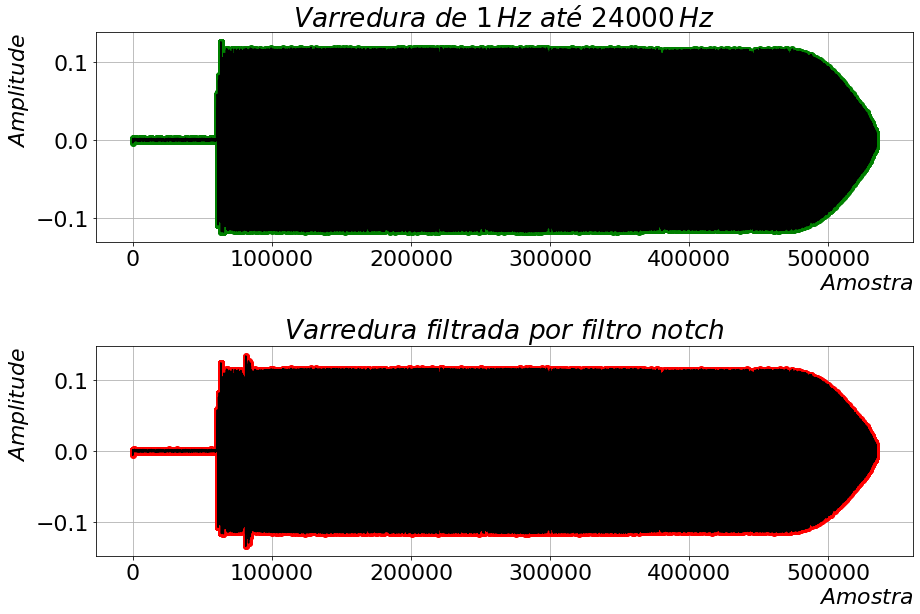

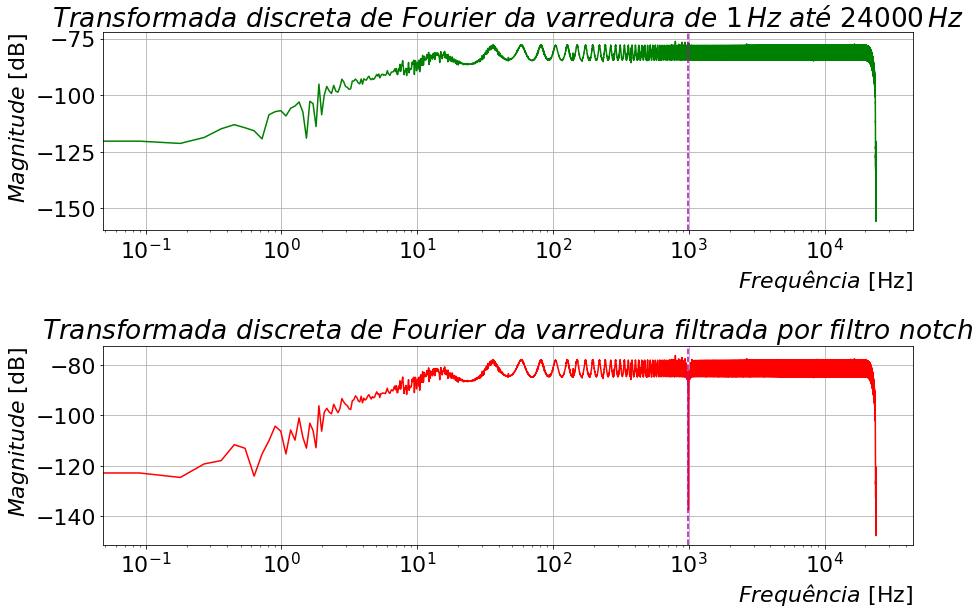

In [20]:
fs, audio = wavfile.read('./áudios/sweep-saida-notch.wav');
sweep48 = audio.T[1][:int(len(audio.T[1])/2.86)].astype(float)/32768;
sweep48notch = audio.T[0][:int(len(audio.T[0])/2.86)].astype(float)/32768;

transweep48 = np.fft.fftshift(np.fft.fft(sweep48)/len(sweep48));
transweep48 = transweep48[int(len(sweep48)/2)::];
freqsweep48 = np.fft.fftshift(np.fft.fftfreq(len(sweep48), d=1/fs));
freqsweep48 = freqsweep48[int(len(sweep48)/2)::];

transweep48notch = np.fft.fftshift(np.fft.fft(sweep48notch)/len(sweep48notch));
transweep48notch = transweep48notch[int(len(sweep48notch)/2)::];
freqsweep48notch = np.fft.fftshift(np.fft.fftfreq(len(sweep48notch), d=1/fs));
freqsweep48notch = freqsweep48notch[int(len(sweep48notch)/2)::];

plt.figure();

plt.subplot(2,1,1);
plt.plot(sweep48, 'go', sweep48, 'k');
plt.title(r'$Varredura \ de \ 1 \, Hz \ até \ 24000 \, Hz$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.subplot(2,1,2);
plt.plot(sweep48notch, 'ro', sweep48notch, 'k');
plt.title(r'$Varredura \ filtrada \ por \ filtro \ notch$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.figure();

plt.subplot(2,1,1);
plt.plot(freqsweep48, 20*np.log10(abs(transweep48)), 'g');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ da \ varredura \ de \ 1 \, Hz \ até \ 24000 \, Hz$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();

plt.subplots_adjust(hspace=1);

plt.subplot(2,1,2);
plt.plot(freqsweep48notch, 20*np.log10(abs(transweep48notch)), 'r');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ da \ varredura \ filtrada \ por \ filtro \ notch$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();
plt.show();

Verifica-se que a magnitude no entorno da frequência de 995 Hz é atenuada, próxima a linha tracejada na imagem acima.

Denota-se que o filtro _notch_ faz a filtragem com a mesma banda de rejeição que na resposta em frequência do filtro projetado. No entanto foi necessário diminuir a amplitude do sinal transmitido para evitar reflexões no processo de filtragem.

Na sequência, o filtro é aplicado no áudio em que o sinal espúrio está presente, no que ele foi gravado no arquivo `'audio-teste-ruido-filtrado-notch-gustavo.wav'` e teve o resultado abaixo.

In [21]:
fs, gravacaonotch = wavfile.read('./áudios/audio-teste-ruido-filtrado-notch-gustavo.wav');
gravacaonotch_orig = gravacaonotch.T[1].astype(float)/32768;
gravacaonotch_filt = gravacaonotch.T[0].astype(float)/32768;

print('Gravação original:');
display(Audio(gravacaonotch_orig, rate=fs, autoplay=False));

print('Gravação filtrada pelo filtro notch:');
display(Audio(gravacaonotch_filt, rate=fs, autoplay=False));

Gravação original:


Gravação filtrada pelo filtro notch:


As curvas do sinal original e do filtrado no tempo abaixo mostram que o sinal espúrio foi reduzido.

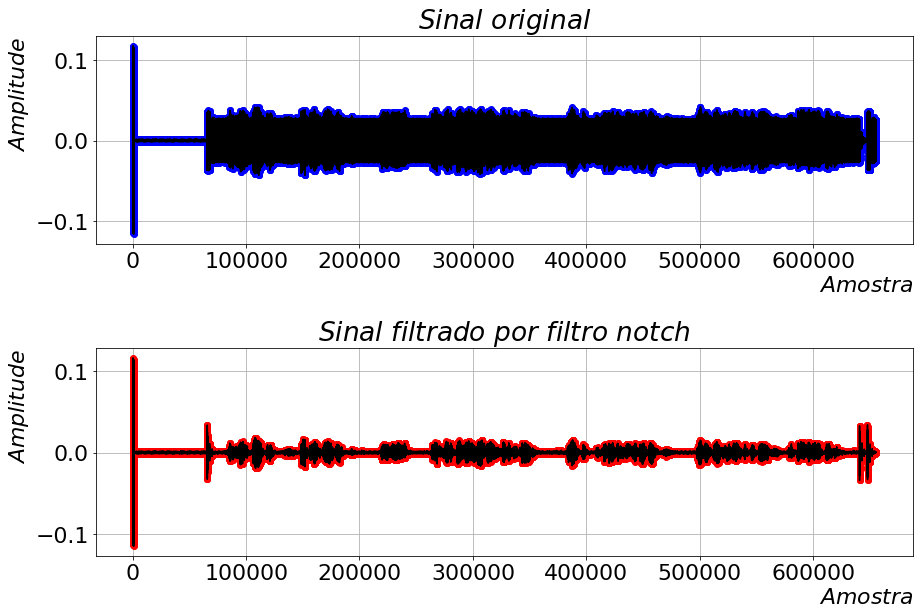

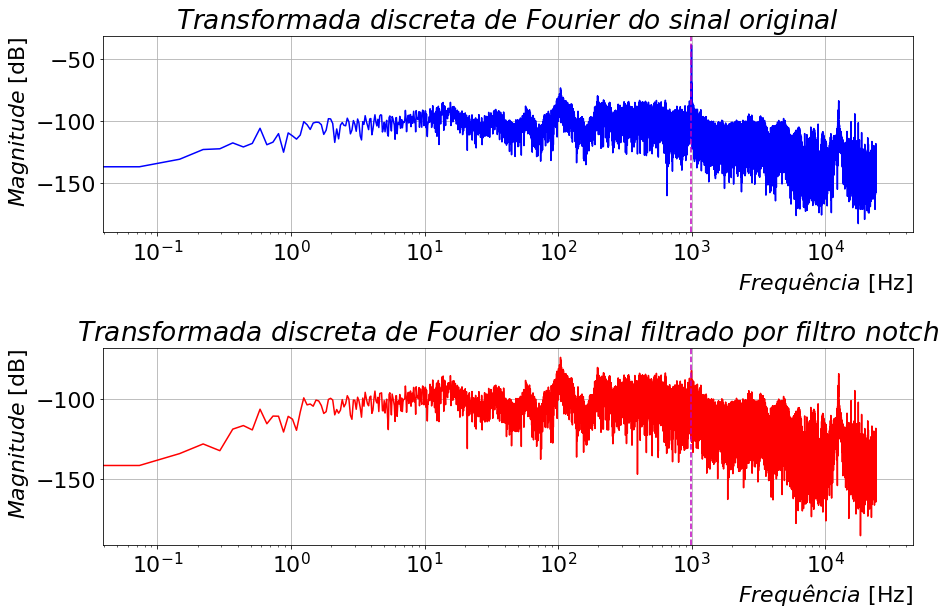

In [22]:
fs, gravacaonotch = wavfile.read('./áudios/audio-teste-ruido-filtrado-notch-gustavo.wav');
gravacaonotch_orig = gravacaonotch.T[1].astype(float)/32768;
gravacaonotch_filt = gravacaonotch.T[0].astype(float)/32768;

tranorig = np.fft.fftshift(np.fft.fft(gravacaonotch_orig)/len(gravacaonotch_orig));
tranorig = tranorig[int(len(gravacaonotch_orig)/2)::];
freqorig = np.fft.fftshift(np.fft.fftfreq(len(gravacaonotch_orig), d=1/fs));
freqorig = freqorig[int(len(gravacaonotch_orig)/2)::];

tranfiltnotch = np.fft.fftshift(np.fft.fft(gravacaonotch_filt)/len(gravacaonotch_filt));
tranfiltnotch = tranfiltnotch[int(len(gravacaonotch_filt)/2)::];
freqfiltnotch = np.fft.fftshift(np.fft.fftfreq(len(gravacaonotch_filt), d=1/fs));
freqfiltnotch = freqfiltnotch[int(len(gravacaonotch_filt)/2)::];

plt.figure();

plt.subplot(2,1,1);
plt.plot(gravacaonotch_orig, 'bo', gravacaonotch_orig, 'k');
plt.title(r'$Sinal \ original$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.subplot(2,1,2);
plt.plot(gravacaonotch_filt, 'ro', gravacaonotch_filt, 'k');
plt.title(r'$Sinal \ filtrado \ por \ filtro \ notch$');
plt.ylabel(r'$Amplitude$');
plt.xlabel(r'$Amostra$');
plt.grid();
plt.tight_layout();

plt.figure();

plt.subplot(2,1,1);
plt.plot(freqorig, 20*np.log10(abs(tranorig)), 'b');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ do \ sinal \ original$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();

plt.subplots_adjust(hspace=1);

plt.subplot(2,1,2);
plt.plot(freqfiltnotch, 20*np.log10(abs(tranfiltnotch)), 'r');
plt.axvline(x=995, color='m', linestyle='--');
plt.title(r'$Transformada \ discreta \ de \ Fourier \ do \ sinal \ filtrado \ por \ filtro \ notch$');
plt.ylabel(r'$Magnitude \ [\mathrm{dB}]$');
plt.xlabel(r'$Frequência \ [\mathrm{Hz}]$');
plt.xscale('log');
plt.grid();
plt.tight_layout();
plt.show();

# 9 Comparação entre filtros<a id='desenvolvimento:9'></a>

Todos os filtros foram capazes de remover o sinal espúrio atrelado à gravação de áudio original. Entretanto, para essa aplicação em específico, é de interesse não atenuar outras frequências além da frequência do ruído. Logo, o filtro _notch_ oferece a melhor seletividade de frequência para esse tipo de sinal quando comparado aos filtros _FIR_ e _IIR_ Elíptico.

Já em relação a complexidade computacional, o filtro _FIR_ requer um maior número de operações por ter uma grande quantidade de coeficientes para sua aplicação, o que pode impedir a implementação em _hardware_ em tempo real caso tenha uma ordem muito alta. Todavia os filtros _IIR_ Elíptico e _notch_ podem ser implementados com uma ordem inferior à 10.

Ademais, o filtro _FIR_ apresenta outras características que possam ser interessantes para outras aplicações, como a garantia de estabilidade, por sempre ter polos no centro da circunferência no domínio discreto e por possuir uma fase linear. Por exemplo, em algumas aplicações de radar é necessário que o filtro utilizado tenha um atraso de grupo constante, o que implica em uma fase linear [[3]](#referencias:3). Portanto, nesses cenários, os filtros _IIR_ Elíptico e o _notch_, que têm fase não linear, não poderiam ser usados.

# Referências<a id='referencias'></a>

<a id='referencias:1'>[1]</a> Podder, P.; Hasan, M.; Islam, R.; Sayeed, M. **Design and Implementation of Butterworth, Chebyshev-I and Elliptic Filter for Speech Signal Analysis**. International Journal of Computer Applications (0975 – 8887), vol. 98, issue 7, July, 2014. DOI: 10.1117/1.JEI.27.5.051219.

<a id='referencias:2'>[2]</a> S.-C. Pei; B.-Y. Guo; W.-Y. Lu. **Narrowband Notch Filter Using Feedback Structure**. IEEE
Signal   Processing   Magazine,   vol.   33,   issue   3,   pp.   115-118.   May,   2016.   DOI:
10.1109/MSP.2016.2531578.

<a id='referencias:3'>[3]</a> ROHDE&SCHWARZ. **Pulsed RADAR signal generation and measurements : Educational Note 1MA234_0e**. Disponível em: https://cdn.rohde-schwarz.com/pws/dl_downloads/dl_application/application_notes/1ma234/1MA234_0e_PulsedRadarEduNote.pdf